# Математика - Итоговая работа

---
## Введение
---

### Описание задания

В качестве итогового задания по блоку «Математика» мы предлагаем вам подготовить отчет с результатами обучения регрессионной модели. Для подготовки такого отчета от вас потребуется применить все знания и навыки, полученные за время прохождения блока. Несмотря на то, что есть ряд требований по оформлению решения и перечню проведенных тестов, мы будем рады, если вы проявите свою индивидуальность в исследуемых датасетах, выдвинутых гипотезах и дизайне.

### Описание данных

| #  | **Столбец**         | **Тип данных** | **Описание** |
|----|---------------------|---------------|-------------|
| 1  | `airline`          | *object*      | Авиакомпания (6 уникальных значений: `IndiGo`, `SpiceJet`, `AirAsia` и др.) |
| 2  | `flight`           | *object*      | Код рейса (уникальный идентификатор рейса) |
| 3  | `source_city`      | *object*      | Город отправления (6 уникальных значений) |
| 4  | `departure_time`   | *object*      | Время вылета (6 временных интервалов: `Night`, `Morning`, `Afternoon` и др.) |
| 5  | `stops`            | *object*      | Количество пересадок (`zero`, `one`, `two_or_more`) |
| 6  | `arrival_time`     | *object*      | Время прилета (6 временных интервалов) |
| 7  | `destination_city` | *object*      | Город прибытия (6 уникальных значений) |
| 8  | `class`            | *object*      | Класс билета (`Economy`, `Business`) |
| 9  | `duration`         | *float64*     | Время в пути (часы) |
| 10 | `days_left`        | *int64*       | Оставшиеся дни до вылета |
| 11 | `price`            | *float64*     | ***Целевая переменная*** – цена авиабилета |

### Цели и задачи

1. **Разведочный анализ (EDA)**  
   - Изучить распределения признаков и различия между сегментами (с помощью гистограмм, плотностей, PSI, KS).
   - Сформировать общую картину, выявить аномалии и особенности данных.
2. **Проверка статистических гипотез**  
   - Сформулировать и протестировать несколько гипотез о разнице ключевых показателей (цены, длительность и т.п.) между группами.
   - Построить точечные и интервальные (бутстрэп) оценки разницы средних и сделать вывод о статистической значимости.
   - Предложить гипотезы и дальнейшие эксперименты по улучшению отстающих групп.
3. **Регрессионный анализ**  
   - Построить линейную регрессию (МНК), интерпретировать коэффициенты.
   - Проверить модель на гетероскедастичность, мультиколлинеарность и при необходимости скорректировать спецификацию.
   - Сравнить несколько моделей и обосновать выбор финальной.
4. **Визуализация и оформление результатов**  
   - Оформить графики (статические и интерактивные) с подписями и краткими комментариями.
   - Структурировать работу (введение, методология, результаты, выводы) и представить её в аккуратном виде.

### Дополнительный комментарий

Долго выбирал датасет и вот под конец работы кажется, что ошибся с выбором, хотя сам датасет и интересный. Надеюсь, что все же большинство получилось релизовать правильно.

### Импорт библиотек и настройка дополнительных параметров

In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
import mplcyberpunk

import scipy.stats as st
import statsmodels.api as sm
from statsmodels.stats.diagnostic import het_breuschpagan
from statsmodels.stats.outliers_influence import variance_inflation_factor

from phik import resources
from phik.report import plot_correlation_matrix

from IPython.display import display

In [2]:
plt.style.use("cyberpunk")

plt.rcParams['figure.autolayout'] = True
plt.rcParams['axes.titleweight'] = 'bold'

---
## Знакомство с данными: загрузка и первичная предобработка
---

### Загрузка датасета

In [3]:
df = pd.read_csv('dataset.csv', index_col=0)

In [4]:
df.head()

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955


### Общая информация о датасете, необходимая для дальнейших действий

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 300153 entries, 0 to 300152
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   airline           300153 non-null  object 
 1   flight            300153 non-null  object 
 2   source_city       300153 non-null  object 
 3   departure_time    300153 non-null  object 
 4   stops             300153 non-null  object 
 5   arrival_time      300153 non-null  object 
 6   destination_city  300153 non-null  object 
 7   class             300153 non-null  object 
 8   duration          300153 non-null  float64
 9   days_left         300153 non-null  int64  
 10  price             300153 non-null  int64  
dtypes: float64(1), int64(2), object(8)
memory usage: 27.5+ MB


In [6]:
df.shape

(300153, 11)

In [7]:
df.columns

Index(['airline', 'flight', 'source_city', 'departure_time', 'stops',
       'arrival_time', 'destination_city', 'class', 'duration', 'days_left',
       'price'],
      dtype='object')

In [8]:
df['stops'].unique()

array(['zero', 'one', 'two_or_more'], dtype=object)

### Анализ пропусков и дубликатов

#### Пропуски

In [9]:
print("Количество пропусков в абсолютных и относительных значениях:")
display(pd.DataFrame({
    'Total NaN': df.isna().sum(),
    'Percentage NaN': df.isna().mean() * 100
}).style.background_gradient('coolwarm').format({'Percentage NaN': '{:.2f}%'}))

Количество пропусков в абсолютных и относительных значениях:


,Total NaN,Percentage NaN
airline,0,0.00%
flight,0,0.00%
source_city,0,0.00%
departure_time,0,0.00%
stops,0,0.00%
arrival_time,0,0.00%
destination_city,0,0.00%
class,0,0.00%
duration,0,0.00%
days_left,0,0.00%


#### Дубликаты

In [10]:
df.duplicated().sum()

np.int64(0)

Датасет чистый, так что результаты ожидаемы

---
## Теория вероятностей и мат. статистика
---

### Распределения числовых столбов

In [11]:
num_cols = ['duration', 'days_left', 'price']

fig = go.Figure()

# Добавляем гистограмму и KDE для каждой переменной
for col in num_cols:

    # Гистограмма
    fig.add_trace(go.Histogram(
        x=df[col], name=f"{col} (гистограмма)", histnorm='probability density',
        opacity=0.6, visible=False
    ))

    # KDE-кривая
    x_values = np.linspace(df[col].min(), df[col].max(), 100)  # Линейная сетка значений
    kde = st.gaussian_kde(df[col])  # Оценка плотности
    kde_y = kde(x_values)

    # Нормируем KDE-кривую к гистограмме
    fig.add_trace(go.Scatter(
        x=x_values, y=kde_y, mode='lines', name=f"{col} (KDE)", visible=False
    ))

# Делаем первую пару графиков видимой (гистограмма + KDE)
fig.data[0].visible = True
fig.data[1].visible = True

# Создаем кнопки для переключения
buttons = []
for i, col in enumerate(num_cols):
    # Создаем список видимости: True только для текущей пары графиков (гистограмма + KDE)
    visibility = [False] * (2 * len(num_cols))  # Две трассы (гистограмма + KDE) на каждую переменную
    visibility[2 * i] = True    # Делаем видимой гистограмму
    visibility[2 * i + 1] = True  # Делаем видимой KDE

    buttons.append(dict(
        label=col,
        method='update',
        args=[{'visible': visibility}, {'title': f"Распределение: {col}"}]
    ))

# Добавляем меню с кнопками
fig.update_layout(
    updatemenus=[{'buttons': buttons, 'direction': 'down', 'showactive': True}],
    title=f"Распределение: {num_cols[0]}",
    xaxis_title="Значение",
    yaxis_title="Плотность",
    xaxis=dict(exponentformat='none'),
    yaxis=dict(exponentformat='none'),
    autosize=True
)

fig.show()

### Анализ выбросов

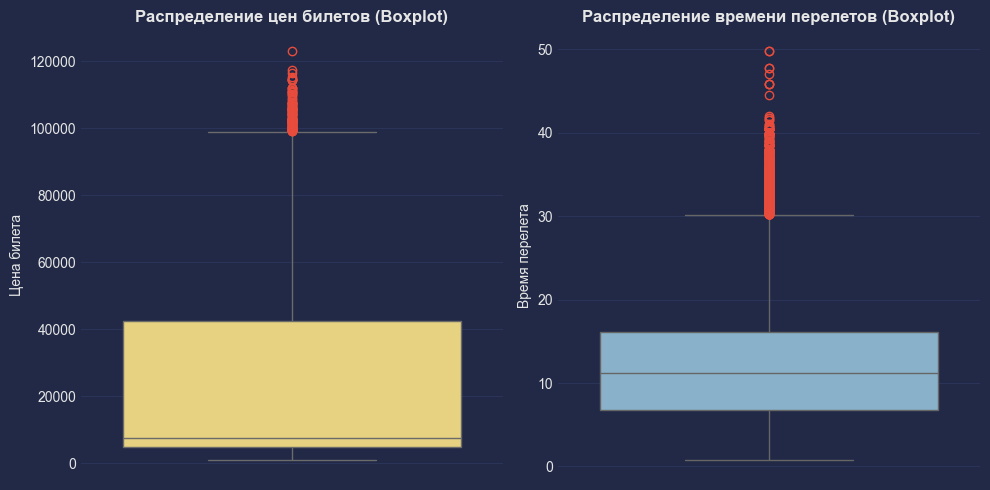

In [12]:
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
sns.boxplot(y=df['price'], color='#f7dc6f',
            flierprops=dict(marker='o', markersize=6, markeredgecolor='#e74c3c'))

plt.title("Распределение цен билетов (Boxplot)")
plt.ylabel("Цена билета")

plt.subplot(1, 2, 2)
sns.boxplot(y=df['duration'], color='#7fb3d5',
            flierprops=dict(marker='o', markersize=6, markeredgecolor='#e74c3c'))

plt.title("Распределение времени перелетов (Boxplot)")
plt.ylabel("Время перелета")

plt.tight_layout()
plt.show()

### Тесты на распределение

Выделим группы по разным критериям на основе данных датасета

In [13]:
df.head()

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955


In [14]:
categorical_columns = df.select_dtypes(include=['object']).columns

for col in categorical_columns:
    print(f"Столбец {col}:")
    print(f"В столбце уникальных значений {df[col].nunique()}")
    print(f"Список значений: {df[col].unique()}")
    print("========================================================================================")

Столбец airline:
В столбце уникальных значений 6
Список значений: ['SpiceJet' 'AirAsia' 'Vistara' 'GO_FIRST' 'Indigo' 'Air_India']
Столбец flight:
В столбце уникальных значений 1561
Список значений: ['SG-8709' 'SG-8157' 'I5-764' ... '6E-7127' '6E-7259' 'AI-433']
Столбец source_city:
В столбце уникальных значений 6
Список значений: ['Delhi' 'Mumbai' 'Bangalore' 'Kolkata' 'Hyderabad' 'Chennai']
Столбец departure_time:
В столбце уникальных значений 6
Список значений: ['Evening' 'Early_Morning' 'Morning' 'Afternoon' 'Night' 'Late_Night']
Столбец stops:
В столбце уникальных значений 3
Список значений: ['zero' 'one' 'two_or_more']
Столбец arrival_time:
В столбце уникальных значений 6
Список значений: ['Night' 'Morning' 'Early_Morning' 'Afternoon' 'Evening' 'Late_Night']
Столбец destination_city:
В столбце уникальных значений 6
Список значений: ['Mumbai' 'Bangalore' 'Kolkata' 'Hyderabad' 'Chennai' 'Delhi']
Столбец class:
В столбце уникальных значений 2
Список значений: ['Economy' 'Business']


#### Тест на распределение: `economy` vs `business`

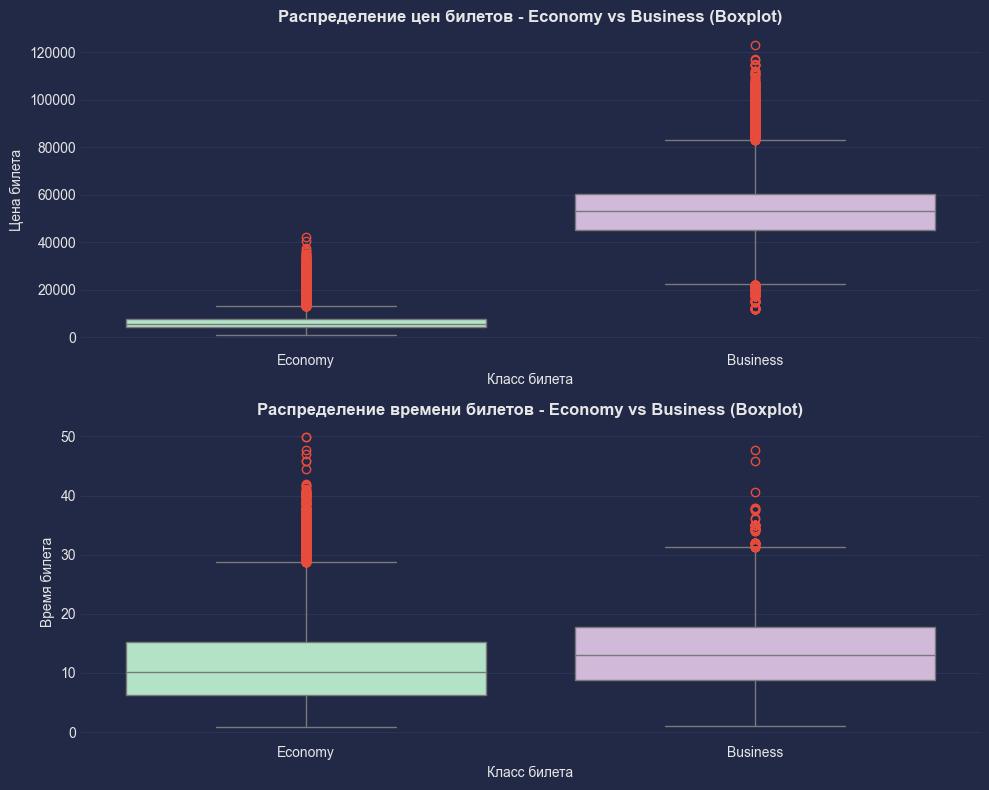

In [15]:
plt.figure(figsize=(10, 8))

plt.subplot(2, 1, 1)

sns.boxplot(x=df['class'], y=df['price'], hue=df['class'], palette=['#abebc6', '#d2b4de'],
               flierprops=dict(marker='o', markersize=6,  markeredgecolor='#e74c3c' 
    ))

plt.title("Распределение цен билетов - Economy vs Business (Boxplot)")
plt.ylabel("Цена билета")
plt.xlabel("Класс билета")

plt.subplot(2, 1, 2)

sns.boxplot(x=df['class'], y=df['duration'], hue=df['class'], palette=['#abebc6', '#d2b4de'],
               flierprops=dict(marker='o', markersize=6,  markeredgecolor='#e74c3c' 
    ))

plt.title("Распределение времени билетов - Economy vs Business (Boxplot)")
plt.ylabel("Время билета")
plt.xlabel("Класс билета")

plt.tight_layout()
plt.show()

In [16]:
df_economy = df[df['class']=='Economy']['price']
df_business = df[df['class']=='Business']['price']

ks_stat, p_value = st.ks_2samp(df_economy, df_business)

print("---------------------------------------------------------------------------------------------")
print("Распределение цен билетов: Economy VS Business")
print("---------------------------------------------------------------------------------------------")
print(f"KS-статистика: {ks_stat:.4f}")
print(f"P-value: {p_value:.4f}")

if p_value < 0.05:
    print("Отвергаем H0: распределения цен билетов в Economy и Business статистически различаются.")
else:
    print("Принимаем H0: различий в распределениях цен между классами билетов нет.")

print("---------------------------------------------------------------------------------------------")

---------------------------------------------------------------------------------------------
Распределение цен билетов: Economy VS Business
---------------------------------------------------------------------------------------------
KS-статистика: 0.9860
P-value: 0.0000
Отвергаем H0: распределения цен билетов в Economy и Business статистически различаются.
---------------------------------------------------------------------------------------------


In [17]:
# Создание интерактивного графика с корректным отображением KDE
fig = go.Figure()

# Добавляем гистограмму и KDE для каждого класса билетов
for data, label, color in zip([df_economy, df_business], ['Economy', 'Business'], ['blue', 'red']):
    # Гистограмма
    fig.add_trace(go.Histogram(
        x=data, name=f"{label} (гистограмма)", histnorm='probability density',
        opacity=0.6, visible=False
    ))

    # KDE-кривая
    x_values = np.linspace(data.min(), data.max(), 100)  # Линейная сетка значений
    kde = st.gaussian_kde(data.dropna())  # Оценка плотности
    kde_y = kde(x_values)

    # Добавляем KDE-кривую
    fig.add_trace(go.Scatter(
        x=x_values, y=kde_y, mode='lines', name=f"{label} (KDE)", visible=False
    ))

# Делаем первую пару графиков видимой (гистограмма + KDE)
fig.data[0].visible = True
fig.data[1].visible = True

# Создаем кнопки для переключения
buttons = []
labels = ['Economy', 'Business']
for i, label in enumerate(labels):
    # Создаем список видимости: True только для текущей пары графиков (гистограмма + KDE)
    visibility = [False] * (2 * len(labels))  # Две трассы (гистограмма + KDE) на каждую переменную
    visibility[2 * i] = True    # Делаем видимой гистограмму
    visibility[2 * i + 1] = True  # Делаем видимой KDE

    buttons.append(dict(
        label=label,
        method='update',
        args=[{'visible': visibility}, {'title': f"Распределение цен билетов: {label}"}]
    ))

# Кнопка для наложения
buttons.append(dict(
    label="Both (Overlay)",
    method="update",
    args=[{'visible': [True] * (2 * len(labels))}, {'title': "Распределение цен билетов (Economy vs Business)"}]
))

# Добавляем меню с кнопками
fig.update_layout(
    updatemenus=[{'buttons': buttons, 'direction': 'down', 'showactive': True}],
    title=f"Распределение цен билетов: {labels[0]}",
    xaxis_title="Цена билета",
    yaxis_title="Плотность",
    xaxis=dict(exponentformat='none'),
    yaxis=dict(exponentformat='none'),
    autosize=True
)


# Отображаем график
fig.show()

#### Тест на распределение между группами `Stop` и `Direct`

In [18]:
direct_flights = df[df['stops'] == 'zero']['price']
stop_flights = df[(df['stops'] == 'one') | (df['stops'] == 'two_or_more')]['price']

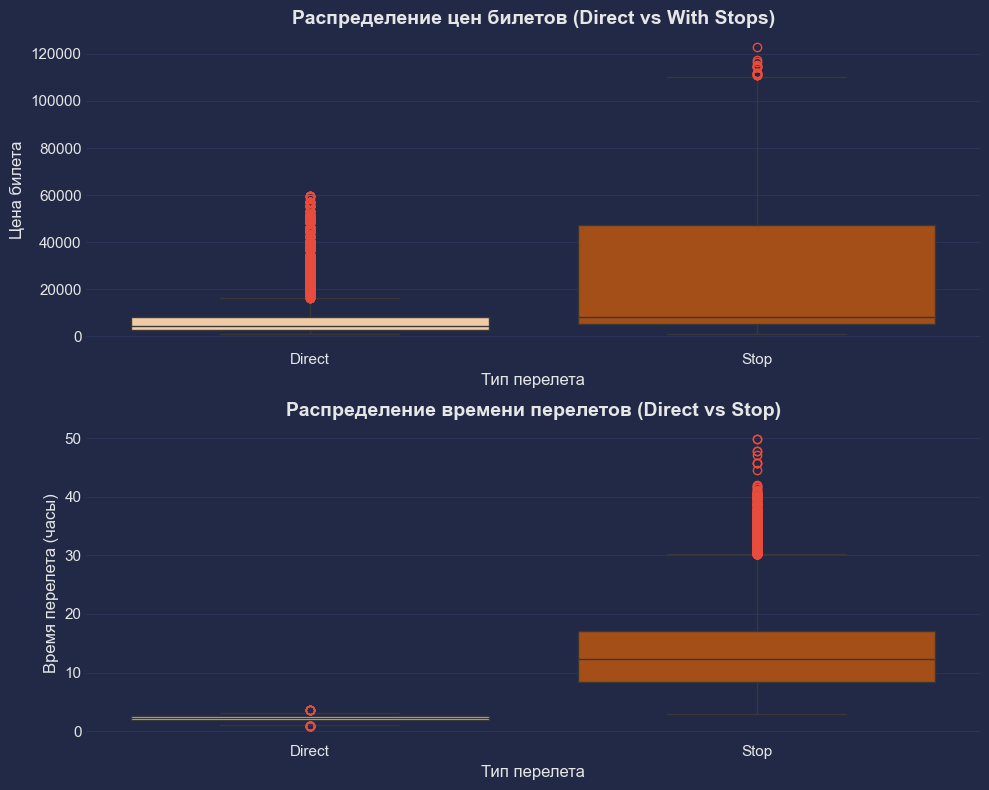

In [19]:
df['flight_type'] = df['stops'].apply(lambda x: 'Direct' if x == 'zero' else 'Stop')

plt.figure(figsize=(10, 8))

# Первый subplot: Boxplot для цены билетов (Direct vs With Stops)
plt.subplot(2, 1, 1)
sns.boxplot(x=df['flight_type'], y=df['price'], hue=df['flight_type'], palette=['#ffcc99', '#ba4a00'],
            flierprops=dict(marker='o', markersize=6, markeredgecolor='#e74c3c'))

plt.title("Распределение цен билетов (Direct vs With Stops)", fontsize=14, fontweight='bold')
plt.xlabel("Тип перелета", fontsize=12)
plt.ylabel("Цена билета", fontsize=12)
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)

# Второй subplot: Boxplot для длительности перелетов (Direct vs With Stops)
plt.subplot(2, 1, 2)
sns.boxplot(x=df['flight_type'], y=df['duration'], hue=df['flight_type'], palette=['#ffcc99', '#ba4a00'],
            flierprops=dict(marker='o', markersize=6, markeredgecolor='#e74c3c'))

plt.title("Распределение времени перелетов (Direct vs Stop)", fontsize=14, fontweight='bold')
plt.xlabel("Тип перелета", fontsize=12)
plt.ylabel("Время перелета (часы)", fontsize=12)
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)

# Уменьшаем расстояние между графиками
plt.subplots_adjust(hspace=0.4)

plt.show()

In [20]:
# KS-тест между прямыми рейсами и рейсами с одной пересадкой
ks_stat, p_value = st.ks_2samp(direct_flights, stop_flights)

print("---------------------------------------------------------------------------------------------")
print("KS-тест между прямыми рейсами и рейсами с одной пересадкой")
print("---------------------------------------------------------------------------------------------")
print(f"KS-статистика: {ks_stat:.4f}")
print(f"P-value: {p_value:.4f}")

if p_value < 0.05:
    print("Отвергаем H0: распределения цен билетов между прямыми перелётами и перелётами с пересадками статистически различаются.")
else:
    print("Принимаем H0: различий в распределениях цен билетов между прямыми перелётами и перелётами с пересадками нет.")

print("---------------------------------------------------------------------------------------------")

---------------------------------------------------------------------------------------------
KS-тест между прямыми рейсами и рейсами с одной пересадкой
---------------------------------------------------------------------------------------------
KS-статистика: 0.3894
P-value: 0.0000
Отвергаем H0: распределения цен билетов между прямыми перелётами и перелётами с пересадками статистически различаются.
---------------------------------------------------------------------------------------------


In [21]:
fig = go.Figure()

# Добавляем гистограмму и KDE для каждого класса билетов
for data, label, color in zip([direct_flights, stop_flights], ['Direct Flights', 'Flights With Stops'], ['#a93226', '#a3e4d7']):
    # Гистограмма
    fig.add_trace(go.Histogram(
        x=data, name=f"{label} (гистограмма)", histnorm='probability density',
        opacity=0.6, visible=False
    ))

    # KDE-кривая
    x_values = np.linspace(data.min(), data.max(), 100)  # Линейная сетка значений
    kde = st.gaussian_kde(data.dropna())  # Оценка плотности
    kde_y = kde(x_values)

    # Добавляем KDE-кривую
    fig.add_trace(go.Scatter(
        x=x_values, y=kde_y, mode='lines', name=f"{label} (KDE)", visible=False
    ))

# Делаем первую пару графиков видимой (гистограмма + KDE)
fig.data[0].visible = True
fig.data[1].visible = True

# Создаем кнопки для переключения
buttons = []
labels = ['Direct Flights', 'Flights With Stops']
for i, label in enumerate(labels):
    # Создаем список видимости: True только для текущей пары графиков (гистограмма + KDE)
    visibility = [False] * (2 * len(labels))  # Две трассы (гистограмма + KDE) на каждую переменную
    visibility[2 * i] = True    # Делаем видимой гистограмму
    visibility[2 * i + 1] = True  # Делаем видимой KDE

    buttons.append(dict(
        label=label,
        method='update',
        args=[{'visible': visibility}, {'title': f"Распределение цен билетов: {label}"}]
    ))

# Кнопка для наложения
buttons.append(dict(
    label="Both (Overlay)",
    method="update",
    args=[{'visible': [True] * (2 * len(labels))}, {'title': "Распределение цен билетов (Direct Flights vs Flights With Stops)"}]
))

# Добавляем меню с кнопками
fig.update_layout(
    updatemenus=[{'buttons': buttons, 'direction': 'down', 'showactive': True}],
    title=f"Распределение цен билетов: {labels[0]}",
    xaxis_title="Цена билета",
    yaxis_title="Плотность",
    xaxis=dict(exponentformat='none'),
    yaxis=dict(exponentformat='none'),
    autosize=True
)


# Отображаем график
fig.show()

Не стал исправлять распределения, логарифмируя или делая иные махинации, ибо решил, что 300 000 наблюдений должны минимизировать отклонения t-теста по ... [дописать]

### Формулировка и проверка гипотез

#### Формулировка гипотез

**Гипотеза 1** (Price: `Business` vs. `Economy`)

- **H0:** Средняя цена билетов в классе `Business` не превышает среднюю цену в классе `Economy` (μ_B - μ_E ≤ 0).
- **H1:** Средняя цена билетов в классе `Business` выше, чем в классе `Economy` (μ_B - μ_E > 0).
- **Тест:** Односторонний t-тест и дополнительный односторонний Манна-Уитни.

**Гипотеза 2** (Price: `Direct` vs. `Stop`)

- **H0:** Средняя цена билетов для прямых рейсов не ниже, чем для рейсов с пересадками (μ_D - μ_S ≥ 0).
- **H1:** Средняя цена билетов для прямых рейсов ниже, чем для рейсов с пересадками (μ_D - μ_S < 0).
- **Тест:** Односторонний t-тест и дополнительный односторонний Манна-Уитни.

**Гипотеза 3** (Duration: `Business` vs. `Economy`)

- **H0:** Средняя длительность перелёта в классах `Business` и `Economy` одинакова (μ_duration_B - μ_duration_E = 0).
- **H1:** Существует статистически значимая разница в средней длительности перелёта между классами (μ_duration_B - μ_duration_E ≠ 0).
- **Тест:** Двусторонний t-тест и дополнительный двусторонний Манна-Уитни.

#### Гипотеза 1

In [22]:
df_economy = df[df['class']=='Economy']['price']
df_business = df[df['class']=='Business']['price']

mean_business = df_business.mean()
mean_economy  = df_economy.mean()
diff_price = mean_business - mean_economy

print("---------------------------------------------------------------------------------------------------------------------")

print(f"Mean Business: {mean_business:.2f}, Mean Economy: {mean_economy:.2f}")
print(f"Разница (Business - Economy): {diff_price:.2f}")

print("---------------------------------------------------------------------------------------------")

# Параметрический тест: t-тест
t_stat, one_sided_p = st.ttest_ind(df_business, df_economy, alternative='greater', equal_var=False)
print(f"T-test (односторонний, Business > Economy): t = {t_stat:.4f}, p-value = {one_sided_p:.4f}")

if one_sided_p < 0.05:
    print("Отвергаем H0: Средняя цена билетов в Business статистически выше, чем в Economy (t-test).")
else:
    print("Принимаем H0: Нет статистически значимой разницы в ценах между Business и Economy (t-test).")

print("---------------------------------------------------------------------------------------------")

# Непараметрический тест: Mann–Whitney U test с альтернативой 'greater'
mw_stat, mw_p = st.mannwhitneyu(df_business, df_economy, alternative='greater')
print(f"Mann–Whitney U test (Business > Economy): U = {mw_stat}, p-value = {mw_p:.4f}")

if mw_p < 0.05:
    print("Отвергаем H0: Распределения цен билетов в Business и Economy статистически различаются (Mann–Whitney).")
else:
    print("Принимаем H0: Нет статистически значимых различий в распределениях цен между Business и Economy (Mann–Whitney).")

print("---------------------------------------------------------------------------------------------------------------------")

---------------------------------------------------------------------------------------------------------------------
Mean Business: 52540.08, Mean Economy: 6572.34
Разница (Business - Economy): 45967.74
---------------------------------------------------------------------------------------------
T-test (односторонний, Business > Economy): t = 1063.8447, p-value = 0.0000
Отвергаем H0: Средняя цена билетов в Business статистически выше, чем в Economy (t-test).
---------------------------------------------------------------------------------------------
Mann–Whitney U test (Business > Economy): U = 19314349710.5, p-value = 0.0000
Отвергаем H0: Распределения цен билетов в Business и Economy статистически различаются (Mann–Whitney).
---------------------------------------------------------------------------------------------------------------------


**Вывод по гипотезе 1**

- Средняя цена в Business значительно выше, чем в Economy (разница ≈ 45967.74).  
- И t-тест, и критерий Манна–Уитни (p-value < 0.05) отвергают нулевую гипотезу и подтверждают, что Business дороже Economy.


#### Гипотеза 2

In [23]:
group_direct = df[df['flight_type'] == 'Direct']['price']
group_stop   = df[df['flight_type'] == 'Stop']['price']

mean_direct = group_direct.mean()
mean_stop   = group_stop.mean()
diff_direct_stop = mean_direct - mean_stop

print("---------------------------------------------------------------------------------------------------------------------")

print(f"Mean Direct: {mean_direct:.2f}, Mean Stop: {mean_stop:.2f}")
print(f"Разница (Direct - Stop): {diff_direct_stop:.2f}")

print("---------------------------------------------------------------------------------------------")

# Параметрический тест: односторонний t‑тест с alternative='less'
t_stat2, p_val2 = st.ttest_ind(group_direct, group_stop, equal_var=False, alternative='less')
print(f"T-test (Direct < Stop): t = {t_stat2:.4f}, p-value = {p_val2:.4f}")

if p_val2 < 0.05:
    print("Отвергаем H0: Средняя цена билетов для прямых рейсов статистически ниже, чем для рейсов с пересадками (t-test).")
else:
    print("Принимаем H0: Нет статистически значимой разницы в ценах между прямыми рейсами и рейсами с пересадками (t-test).")

print("---------------------------------------------------------------------------------------------")

# Непараметрический тест: Mann–Whitney U test с alternative='less'
mw_stat2, mw_p2 = st.mannwhitneyu(group_direct, group_stop, alternative='less')
print(f"Mann–Whitney U test (Direct < Stop): U = {mw_stat2}, p-value = {mw_p2:.4f}")

if mw_p2 < 0.05:
    print("Отвергаем H0: Распределения цен билетов для прямых рейсев статистически ниже, чем для рейсов с пересадками (Mann–Whitney).")
else:
    print("Принимаем H0: Нет статистически значимых различий в распределениях цен между прямыми рейсами и рейсами с пересадками (Mann–Whitney).")

print("---------------------------------------------------------------------------------------------------------------------")

---------------------------------------------------------------------------------------------------------------------
Mean Direct: 9375.94, Mean Stop: 22459.00
Разница (Direct - Stop): -13083.06
---------------------------------------------------------------------------------------------
T-test (Direct < Stop): t = -181.1756, p-value = 0.0000
Отвергаем H0: Средняя цена билетов для прямых рейсов статистически ниже, чем для рейсов с пересадками (t-test).
---------------------------------------------------------------------------------------------
Mann–Whitney U test (Direct < Stop): U = 2549488655.5, p-value = 0.0000
Отвергаем H0: Распределения цен билетов для прямых рейсев статистически ниже, чем для рейсов с пересадками (Mann–Whitney).
---------------------------------------------------------------------------------------------------------------------


**Вывод по гипотезе 2**

- Средняя цена прямых рейсов (≈ 9375.94) ниже, чем рейсов с пересадками (≈ 22459.00), разница ≈ –13083.06.  
- Односторонний t-тест и критерий Манна–Уитни (p-value < 0.05) показывают, что Direct статистически дешевле Stop.

#### Гипотеза 3

In [24]:
group_duration_business = df[df['class'] == 'Business']['duration']
group_duration_economy  = df[df['class'] == 'Economy']['duration']

mean_duration_business = group_duration_business.mean()
mean_duration_economy  = group_duration_economy.mean()
diff_duration = mean_duration_business - mean_duration_economy

print("---------------------------------------------------------------------------------------------------------------------")

print(f"Mean Duration Business: {mean_duration_business:.2f}, Mean Duration Economy: {mean_duration_economy:.2f}")
print(f"Разница в длительности (Business - Economy): {diff_duration:.2f}")

# Параметрический тест: двусторонний t‑тест (alternative по умолчанию 'two-sided')
t_stat3, p_val3 = st.ttest_ind(group_duration_business, group_duration_economy, equal_var=False, alternative='two-sided')
print(f"T-test (двусторонний): t = {t_stat3:.4f}, p-value = {p_val3:.4f}")

if p_val3 < 0.05:
    print("Отвергаем H0: Длительность перелёта между Business и Economy статистически различается (t-test).")
else:
    print("Принимаем H0: Нет статистически значимой разницы в длительности перелёта между Business и Economy (t-test).")

print("---------------------------------------------------------------------------------------------")

# Непараметрический тест: двусторонний Mann–Whitney U test
mw_stat3, mw_p3 = st.mannwhitneyu(group_duration_business, group_duration_economy, alternative='two-sided')
print(f"Mann–Whitney U test (двусторонний): U = {mw_stat3}, p-value = {mw_p3:.4f}")

if mw_p3 < 0.05:
    print("Отвергаем H0: Распределения длительности перелёта между Business и Economy статистически различаются (Mann–Whitney).")
else:
    print("Принимаем H0: Нет статистически значимых различий в распределениях длительности перелёта между Business и Economy (Mann–Whitney).")

print("---------------------------------------------------------------------------------------------------------------------")

---------------------------------------------------------------------------------------------------------------------
Mean Duration Business: 13.70, Mean Duration Economy: 11.55
Разница в длительности (Business - Economy): 2.15
T-test (двусторонний): t = 78.3473, p-value = 0.0000
Отвергаем H0: Длительность перелёта между Business и Economy статистически различается (t-test).
---------------------------------------------------------------------------------------------
Mann–Whitney U test (двусторонний): U = 11631583295.0, p-value = 0.0000
Отвергаем H0: Распределения длительности перелёта между Business и Economy статистически различаются (Mann–Whitney).
---------------------------------------------------------------------------------------------------------------------


**Вывод по гипотезе 3**

- Средняя длительность перелёта в Business (≈ 13.70) выше, чем в Economy (≈ 11.55), разница ≈ 2.15.  
- Двусторонний t-тест и критерий Манна–Уитни (p-value < 0.05) отвергают равенство средних и подтверждают, что Business и Economy отличаются по длительности.


#### Точечная и интервальная оценки для гипотез

In [25]:
# Функция для бутстрэповой оценки разницы средних
def bootstrap_mean_diff(sample1, sample2, n_boot=10_000, alpha=0.05, random_state=42):
    """
    Возвращает:
      point_estimate: точечная оценка (средняя разница)
      ci_lower, ci_upper: границы (1 - alpha)*100% бутстрэпового доверительного интервала
    """
    np.random.seed(random_state)
    diffs = []
    for _ in range(n_boot):
        s1 = np.random.choice(sample1, size=len(sample1), replace=True)
        s2 = np.random.choice(sample2, size=len(sample2), replace=True)
        diffs.append(s1.mean() - s2.mean())
    diffs = np.array(diffs)
    point_estimate = diffs.mean()
    ci_lower = np.percentile(diffs, (alpha/2)*100)
    ci_upper = np.percentile(diffs, (1 - alpha/2)*100)
    return point_estimate, ci_lower, ci_upper

# Считаем точечную и интервальную оценки (бутстрэп) для каждой гипотезы

point_est_1, ci_low_1, ci_up_1 = bootstrap_mean_diff(df_business, df_economy) # Гипотеза 1: (Business vs Economy, Price)
point_est_2, ci_low_2, ci_up_2 = bootstrap_mean_diff(group_direct, group_stop) # Гипотеза 2: (Direct vs Stop, Price)
point_est_3, ci_low_3, ci_up_3 = bootstrap_mean_diff(group_duration_business, group_duration_economy) # Гипотеза 3: (Business vs Economy, Duration)

# Собираем результаты в единый DataFrame

results_df = pd.DataFrame({
    'Comparison': [
        'Business vs Economy (Price)',
        'Direct vs Stop (Price)',
        'Business vs Economy (Duration)'
    ],
    'Point Estimate': [point_est_1, point_est_2, point_est_3],
    'CI Lower (95%)': [ci_low_1, ci_low_2, ci_low_3],
    'CI Upper (95%)': [ci_up_1, ci_up_2, ci_up_3]
})

# Округлим числа для удобства чтения
results_df['Point Estimate'] = results_df['Point Estimate'].round(2)
results_df['CI Lower (95%)'] = results_df['CI Lower (95%)'].round(2)
results_df['CI Upper (95%)'] = results_df['CI Upper (95%)'].round(2)

display(results_df)

,Comparison,Point Estimate,CI Lower (95%),CI Upper (95%)
0,Business vs Economy (Price),45968.07,45883.50,46051.90
1,Direct vs Stop (Price),-13083.91,-13225.55,-12942.98
2,Business vs Economy (Duration),2.15,2.10,2.21


**Вывод**

1. **Business vs Economy** (`Price`)
    - Точечная оценка разницы: ~ 45 968 ₽ (`Business` минус `Economy`).
    - 95% доверительный интервал: от 45 883 ₽ до 46 052 ₽.
    - *Вывод:* Цена билетов в Business в среднем на ~46 тыс. ₽ выше, чем в Economy (интервал полностью лежит выше нуля).
2. **Direct vs Stop** (`Price`)
    - Точечная оценка разницы: ~ −13 084 ₽ (`Direct` минус `Stop`).
    - 95% доверительный интервал: от −13 226 ₽ до −12 943 ₽.
    - *Вывод:* Цена билетов на прямые рейсы в среднем ~13 тыс. ₽ ниже, чем на рейсы с пересадками (интервал полностью лежит ниже нуля).
3. **Business vs Economy** (`Duration`)
    - Точечная оценка разницы: ~ 2.15 (`Business` минус `Economy`).
    - 95% доверительный интервал: от 2.10 до 2.21.
    - *Вывод:* Длительность перелёта в Business-классе в среднем примерно на 2.15 (часа/минуты) выше, чем в Economy (интервал положительный).

### Продуктовые гипотезы, почему такое могло произойти и предложить идеи, какие эксперименты можно было провести на отстающей группе для повышения показателей

Хотел выбрать что-то поадекватней, а в итоге как всегда : )

**Продуктовые гипотезы и идеи для улучшения**

1. Разница цен между `Business` и `Economy`  
   - Гипотеза: Для бизнес-класса создаётся искусственно высокий ценовой порог из-за ограниченного предложения (меньше мест) и готовности пассажиров платить за комфорт.  
   - Почему так могло произойти:  
     • Низкая эластичность спроса на бизнес-класс (корпоративные клиенты и путешественники с высокими доходами).  
     • Ограниченное предложение мест и приоритетное сервисное обслуживание.  
   - Идеи для экспериментов:  
     • Создать промежуточный продукт «Business Light» и оценить спрос.  
     • Тестировать динамическое ценообразование (скидки при низкой загрузке).  
     • Запустить A/B-тест разных наборов услуг (гибкость билета, дополнительные сервисы).

2. `Direct` vs `Stop` (цены и востребованность)  
   - Гипотеза: Прямые рейсы дешевле в среднем, поскольку авиакомпании могут снижать часть расходов на пересадки и намеренно стимулировать спрос.  
   - Почему так могло произойти:  
     • Маркетинговая стратегия конкурирующих авиалиний, снижающих цену на прямые маршруты.  
     • Потребность увеличить загрузку прямых рейсов и повысить узнаваемость направления.  
   - Идеи для экспериментов:  
     • Добавлять ценные бонусы при выборе пересадок (баллы, мили, апгрейды).  
     • Пересмотреть расписание и стыковки, предложить «две столицы за одну поездку».  
     • Тестировать альтернативные программы лояльности, чтобы понять, меняется ли спрос на Stop.

3. Длительность `Business` vs `Economy` 
   - Гипотеза: Маршруты для бизнес-класса могут быть более сложными или включать дополнительные сегменты, что удлиняет время полёта.  
   - Почему так могло произойти:  
     • Использование бизнес-тарифов на направлениях с дополнительными остановками.  
     • Наличие «буферов» в расписании для гибкости в случае задержек.  
   - Идеи для экспериментов:  
     • Сократить длительность бизнес-рейсов (уменьшить стыковки, оптимизировать расписание) и отследить, повлияет ли это на спрос.  
     • Предложить «бизнес-лайт-маршруты» с меньшим набором услуг, но более коротким перелётом.  
     • Исследовать альтернативные аэропорты и ранние/поздние вылеты, где меньше загруженность.

**Общая идея по работе с отстающими группами**

- Сегментировать клиентов по цене билета, цели поездки, гибкости дат и запускать A/B-тесты с изменением цены, дополнительных услуг, промоакций.  
- Анализировать результаты (продажи, маржинальность, удовлетворённость) и корректировать стратегию.  
- Оптимизировать предложение, используя закономерности спроса и ценовой эластичности.  

---
## Регрессионный анализ
---

### Предварительный анализ датасета и корреляции признаков

In [26]:
df.head()

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price,flight_type
0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953,Direct
1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953,Direct
2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956,Direct
3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955,Direct
4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955,Direct


interval columns not set, guessing: ['duration', 'days_left', 'price']


Text(0.5, 1.0, 'Phik-корреляция между столбцами')

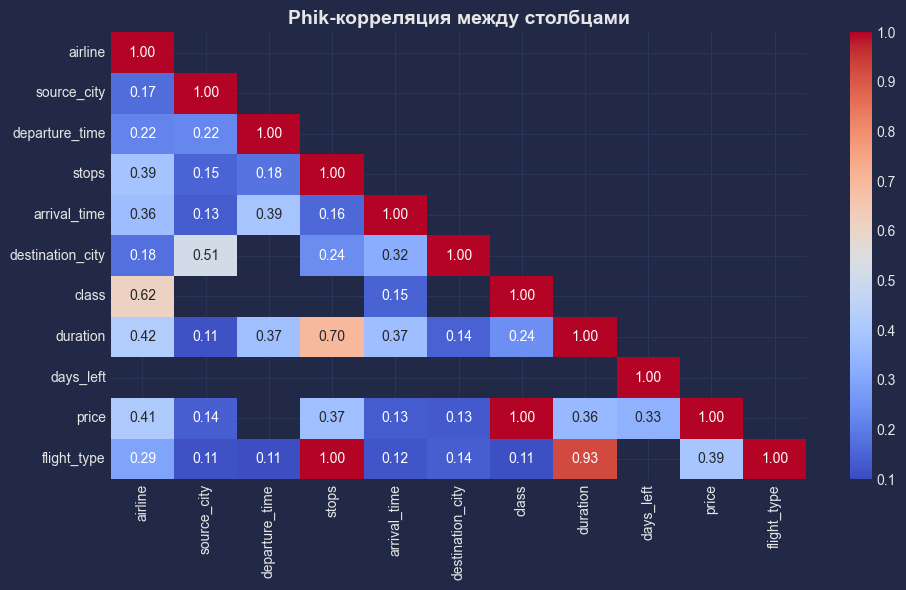

In [27]:
phik_corr = df.drop(columns=['flight']).phik_matrix()

# Создаём маску для скрытия части выше главной диагонали
mask = np.triu(np.ones_like(phik_corr, dtype=bool), k=1)

# Убираем слабые корреляции
phik_corr_filtered = phik_corr.copy()
phik_corr_filtered[phik_corr_filtered < 0.1] = np.nan #условное ограничение - решил убрать ниже 0.1

plt.figure(figsize=(10, 6))
sns.heatmap(phik_corr_filtered, mask=mask, annot=True, fmt='.2f', cmap='coolwarm', vmin=0.1, vmax=1)

plt.title("Phik-корреляция между столбцами", fontsize=14)

### Построение модели линейной регрессии №1 методом МНК и её оценка

**Описание переменных:**
- `price` - таргет 
- `airline`, `source_city`, `departure_time`, `stops`, `arrival_time`, `destination_city`, `class`, `duration`, `days_left` - независимые переменные
- Категориальные переменные переведены в дамми-переменные

In [28]:
model1_columns = [
    'airline', 
    'source_city', 
    'departure_time', 
    'stops', 
    'arrival_time', 
    'destination_city', 
    'class', 
    'duration', 
    'days_left', 
    'price'
]

df_model = df[model1_columns].copy()

cat_columns = list(df_model.columns[:-3])

df_dummies = pd.get_dummies(df_model, columns=cat_columns, drop_first=True)

# Таргет или зависимая переменная
y = df_dummies['price']

# Оставляем только признаки
X = df_dummies.drop('price', axis=1).astype('float')

# Добавляем константу вручную (столбец единиц)
X = sm.add_constant(X)

# Строим модель
model = sm.OLS(y, X).fit()

# Выводим сводку результатов
display(model.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.911
Model:                            OLS   Adj. R-squared:                  0.911
Method:                 Least Squares   F-statistic:                 1.030e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:45:45   Log-Likelihood:            -3.0726e+06
No. Observations:              300153   AIC:                         6.145e+06
Df Residuals:                  300122   BIC:                         6.146e+06
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                         5.257e+04     94.286    557.511      0.000    5.24e+04    5.28e+04
duration                        42.5731      2.344     18.160      0.000      37.978      47.168
days_left                     -130.9517      0.912   -143.647      0.000    -132.738    -129.165
airline_Air_India              116.4140     62.962      1.849      0.064      -6.990     239.818
airline_GO_FIRST              1705.7026     70.217     24.292      0.000    1568.080    1843.325
airline_Indigo                2107.1783     64.313     32.764      0.000    1981.126    2233.230
airline_SpiceJet              2294.1916     91.066     25.193      0.000    2115.705    2472.678
airline_Vistara               4071.5088     60.978     66.770      0.000    3951.994    4191.024
source_city_Chennai            -67.4818     46.273     -1.458      0.145    -158.176      23.213
source_city_Delhi            -1405.9013     42.012    -33.465      0.000   -1488.243   -1323.560
source_city_Hyderabad        -1679.0324     45.914    -36.569      0.000   -1769.023   -1589.042
source_city_Kolkata           1583.7058     44.475     35.609      0.000    1496.537    1670.875
source_city_Mumbai            -211.8791     41.834     -5.065      0.000    -293.872    -129.886
departure_time_Early_Morning   835.6850     41.381     20.195      0.000     754.579     916.791
departure_time_Evening         733.8114     42.047     17.452      0.000     651.400     816.222
departure_time_Late_Night     1694.4629    191.676      8.840      0.000    1318.784    2070.142
departure_time_Morning         856.3184     40.468     21.160      0.000     777.002     935.635
departure_time_Night           690.1368     45.581     15.141      0.000     600.800     779.474
stops_two_or_more             2105.3377     62.003     33.955      0.000    1983.813    2226.862
stops_zero                   -7585.7538     45.922   -165.188      0.000   -7675.759   -7495.748
arrival_time_Early_Morning    -771.9774     66.252    -11.652      0.000    -901.829    -642.126
arrival_time_Evening           924.6971     42.840     21.585      0.000     840.731    1008.663
arrival_time_Late_Night        953.2546     69.734     13.670      0.000     816.579    1089.931
arrival_time_Morning           476.6186     45.039     10.582      0.000     388.343     564.895
arrival_time_Night            1142.6035     41.975     27.221      0.000    1060.334    1224.873
destination_city_Chennai      -219.8228     45.868     -4.793      0.000    -309.723    -129.923
destination_city_Delhi       -1553.8495     43.057    -36.089      0.000   -1638.239   -1469.460
destination_city_Hyderabad   -1720.0619     45.470    -37.828      0.000   -1809.182   -1630.942
destination_city_Kolkata      1376.7858     43.904     31.359      0.000    

**Вывод:**

1. Общая оценка качества  
- R^2 = 0.911: модель объясняет 91 % вариации цены.  
- Высокая F-статистика (p-value = 0.000): регрессия значима в целом.

2. Основные результаты  
- Переменные `duration` (длительность полёта) и `days_left` (дни до вылета) имеют ожидаемые и статистически значимые эффекты.  
- Большинство бинарных переменных (авиакомпании, города, время вылета/прилёта, класс билета) также значимы.  
- Некоторые переменные (например, `airline_Go_FIRST`, `source_city_Chennai`, `source_city_Hyderabad` и другие) оказались незначимыми (p-value > 0.05).

3. Предпосылки Гаусса–Маркова  
- Линейность: соблюдена (модель OLS).  
- Независимость ошибок: вероятно нарушена (Durbin–Watson = 0.336).  
- Отсутствие мультиколлинеарности: число обусловленности 490 может указывать на проблему.  
- Гомоскедастичность: не подтверждена, нужно проверить.  
- Нормальность остатков: отвергается (Omnibus, Jarque–Bera p-value = 0.000).

4. Дополнительные проверки  
- Тест Бреуша–Пагана (проверка гетероскедастичности).  
- Расчёт VIF (оценка мультиколлинеарности).  
- Учет автокорреляции (использование робастных стандартных ошибок или альтернативных методов).

В целом модель хорошо объясняет цену, но для корректных выводов требуется более детальный анализ предпосылок и устранение нарушений (особенно автокорреляции и возможной гетероскедастичности).

### Дополнительная проверка модели 1 на соответствие предпосылкам Гаусса-Маркова

#### QQ-plot для остатков

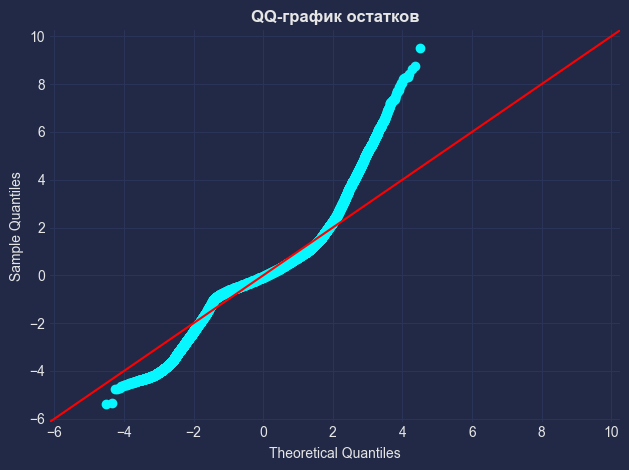

In [29]:
residuals = model.resid

fig = sm.qqplot(residuals, line='45', fit=True)
plt.title("QQ-график остатков")
plt.show()

- Кривая остатков существенно отклоняется от прямой линии.  
- Верхняя и нижняя «хвосты» распределения более тяжёлые, чем у нормального.  
- Это подтверждает, что остатки не распределены нормально.

#### Тест Бреуша-Пагана

- H0: Ошибки гомоскедастичны (дисперсия постоянна).
- H1: Гетероскедастичность присутствует.

In [30]:
bp_test = het_breuschpagan(model.resid, model.model.exog)
lm_stat, lm_pvalue, f_stat, f_pvalue = bp_test

print("--------------------------------------------------------------------------------")
print("Результаты теста Бреуша-Пагана:")
print("--------------------------------------------------------------------------------")

print(f"LM statistic: {lm_stat:.4f}, LM p-value: {lm_pvalue:.4f}")
print(f"F statistic: {f_stat:.4f}, F p-value: {f_pvalue:.4f}")

if lm_pvalue < 0.05:
    print("Есть признаки гетероскедастичности (отвергаем H0).")
else:
    print("Нет статистически значимых признаков гетероскедастичности (не отвергаем H0).")

print("--------------------------------------------------------------------------------")

--------------------------------------------------------------------------------
Результаты теста Бреуша-Пагана:
--------------------------------------------------------------------------------
LM statistic: 60232.3923, LM p-value: 0.0000
F statistic: 2511.5344, F p-value: 0.0000
Есть признаки гетероскедастичности (отвергаем H0).
--------------------------------------------------------------------------------


- LM и F статистики с очень малыми p-value (0.000).  
- Нулевая гипотеза о гомоскедастичности отвергается.  
- Есть признаки гетероскедастичности (дисперсия ошибок не постоянна).

#### VIF

In [31]:
# Создадим DataFrame для VIF
X_no_const = X.drop('const', axis=1, errors='ignore')  # если добавляли константу
vif_data = pd.DataFrame()
vif_data['feature'] = X_no_const.columns
vif_data['VIF'] = [
    variance_inflation_factor(X_no_const.values, i)
    for i in range(X_no_const.shape[1])
]

display(vif_data.sort_values(by='VIF', ascending=False).style.background_gradient('coolwarm'))

,feature,VIF
6,airline_Vistara,7.215791
0,duration,6.898243
2,airline_Air_India,5.253537
1,days_left,4.354006
29,class_Economy,3.750826
23,arrival_time_Night,3.097068
4,airline_Indigo,2.871859
20,arrival_time_Evening,2.819292
22,arrival_time_Morning,2.563478
13,departure_time_Evening,2.390200


- Наиболее высокие значения VIF (7.21 у airline_Vistara, 6.89 у duration) говорят о том, что между некоторыми признаками есть умеренная мультиколлинеарность.  
- Однако значения в районе 7 пока нельзя назвать критическими (чаще критическое значение берут от 10).  
- Тем не менее стоит иметь в виду, что корреляции между факторами присутствуют и могут влиять на точность оценок.  

#### Итоговый вывод по модели

Модель с R^2 ≈ 0.911 и высокой F-статистикой (p-value = 0.000) хорошо объясняет цену: большинство переменных (длительность, дни до вылета, авиакомпания, город и т.п.) оказываются значимыми, хотя есть и незначимые факторы. Однако некоторые предпосылки OLS нарушены: Durbin–Watson ≈ 0.336 указывает на автокорреляцию остатков, QQ-график — на отклонения от нормальности, тест Бреуша–Пагана подтверждает гетероскедастичность, а VIF вплоть до 7 указывает на умеренную мультиколлинеарность.

**Что в теории можно сделать дальше:**
1. Применить робастные стандартные ошибки или логарифмировать целевую переменную.  
2. Учитывать возможную автокорреляцию (использовать соответствующие методы или модели).  
3. Исключить или трансформировать факторы с самым высоким VIF (либо применить регуляризацию).  
4. Проверить влияние выбросов и при необходимости скорректировать модель.  

#### Сведем в табличку момент с предпосылками

| Предпосылка                              | Вывод                                                     | Возможные действия                                                               |
|------------------------------------------|-----------------------------------------------------------|----------------------------------------------------------------------------------|
| *Линейность*                             | Модель специфицирована в линейной форме; условие выполнено | Нет необходимости в корректировках                                               |
| *Независимость ошибок*                     | Durbin–Watson ≈ 0.336 указывает на автокорреляцию          | Можно использовать робастные ошибки (Newey–West) |
| *Отсутствие мультиколлинеарности*          | Значения VIF (до 7) говорят об умеренной мультиколлинеарности | Исключать/трансформировать факторы с высоким VIF; при необходимости применять регуляризацию |
| *Гомоскедастичность*                       | Тест Бреуша–Пагана (p-value = 0.000) → гетероскедастичность | Применять робастные стандартные ошибки; логарифмировать целевую переменную или факторы |
| *(Необязательная) Нормальность остатков*   | QQ-график и Jarque–Bera (p-value = 0.000) → остатки не нормальны | Логарифмировать цену; рассмотреть другие нелинейные преобразования; проверить выбросы |

In [32]:
model_robust = model.get_robustcov_results(cov_type='HC1')
display(model_robust.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.911
Model:                            OLS   Adj. R-squared:                  0.911
Method:                 Least Squares   F-statistic:                 6.691e+04
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:17   Log-Likelihood:            -3.0726e+06
No. Observations:              300153   AIC:                         6.145e+06
Df Residuals:                  300122   BIC:                         6.146e+06
Df Model:                          30                                         
Covariance Type:                  HC1                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                         5.257e+04     86.981    604.337      0.000    5.24e+04    5.27e+04
duration                        42.5731      2.297     18.534      0.000      38.071      47.075
days_left                     -130.9517      0.972   -134.661      0.000    -132.858    -129.046
airline_Air_India              116.4140     43.630      2.668      0.008      30.900     201.928
airline_GO_FIRST              1705.7026     38.744     44.024      0.000    1629.765    1781.641
airline_Indigo                2107.1783     39.422     53.451      0.000    2029.911    2184.445
airline_SpiceJet              2294.1916     55.101     41.636      0.000    2186.195    2402.188
airline_Vistara               4071.5088     38.153    106.715      0.000    3996.729    4146.288
source_city_Chennai            -67.4818     46.555     -1.449      0.147    -158.729      23.765
source_city_Delhi            -1405.9013     42.471    -33.102      0.000   -1489.144   -1322.659
source_city_Hyderabad        -1679.0324     44.134    -38.044      0.000   -1765.534   -1592.530
source_city_Kolkata           1583.7058     43.884     36.088      0.000    1497.694    1669.718
source_city_Mumbai            -211.8791     42.204     -5.020      0.000    -294.598    -129.160
departure_time_Early_Morning   835.6850     39.935     20.926      0.000     757.414     913.956
departure_time_Evening         733.8114     41.727     17.586      0.000     652.028     815.595
departure_time_Late_Night     1694.4629    135.129     12.540      0.000    1429.614    1959.312
departure_time_Morning         856.3184     40.334     21.231      0.000     777.266     935.371
departure_time_Night           690.1368     45.939     15.023      0.000     600.097     780.176
stops_two_or_more             2105.3377     59.582     35.335      0.000    1988.559    2222.116
stops_zero                   -7585.7538     56.866   -133.396      0.000   -7697.210   -7474.297
arrival_time_Early_Morning    -771.9774     62.987    -12.256      0.000    -895.430    -648.525
arrival_time_Evening           924.6971     41.464     22.301      0.000     843.428    1005.966
arrival_time_Late_Night        953.2546     53.329     17.875      0.000     848.732    1057.777
arrival_time_Morning           476.6186     45.650     10.441      0.000     387.145     566.092
arrival_time_Night            1142.6035     41.973     27.222      0.000    1060.337    1224.870
destination_city_Chennai      -219.8228     45.006     -4.884      0.000    -308.033    -131.613
destination_city_Delhi       -1553.8495     43.899    -35.396      0.000   -1639.891   -1467.808
destination_city_Hyderabad   -1720.0619     44.891    -38.316      0.000   -1808.048   -1632.076
destination_city_Kolkata      1376.7858     43.355     31.756      0.000    

### Попытка подправить робастным методом

In [33]:
# Таргет или зависимая переменная
y_log = np.log(df_dummies['price'])

# Строим модель
model_log_price = sm.OLS(y_log, X).fit()

model_log_price_rob = model_log_price.get_robustcov_results(cov_type='HC1')

# Выводим сводку результатов
display(model_log_price.summary())
display(model_log_price_rob.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.915
Model:                            OLS   Adj. R-squared:                  0.915
Method:                 Least Squares   F-statistic:                 1.082e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:18   Log-Likelihood:                -87421.
No. Observations:              300153   AIC:                         1.749e+05
Df Residuals:                  300122   BIC:                         1.752e+05
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           10.5958      0.005   2344.196      0.000      10.587      10.605
duration                         0.0036      0.000     31.872      0.000       0.003       0.004
days_left                       -0.0144   4.37e-05   -329.802      0.000      -0.014      -0.014
airline_Air_India                0.5221      0.003    172.969      0.000       0.516       0.528
airline_GO_FIRST                 0.4147      0.003    123.206      0.000       0.408       0.421
airline_Indigo                   0.3231      0.003    104.808      0.000       0.317       0.329
airline_SpiceJet                 0.4693      0.004    107.499      0.000       0.461       0.478
airline_Vistara                  0.6460      0.003    220.972      0.000       0.640       0.652
source_city_Chennai             -0.0466      0.002    -21.026      0.000      -0.051      -0.042
source_city_Delhi               -0.0270      0.002    -13.395      0.000      -0.031      -0.023
source_city_Hyderabad           -0.0889      0.002    -40.371      0.000      -0.093      -0.085
source_city_Kolkata              0.1411      0.002     66.188      0.000       0.137       0.145
source_city_Mumbai              -0.0463      0.002    -23.105      0.000      -0.050      -0.042
departure_time_Early_Morning     0.0195      0.002      9.835      0.000       0.016       0.023
departure_time_Evening          -0.0091      0.002     -4.529      0.000      -0.013      -0.005
departure_time_Late_Night        0.0418      0.009      4.546      0.000       0.024       0.060
departure_time_Morning           0.0350      0.002     18.050      0.000       0.031       0.039
departure_time_Night            -0.0069      0.002     -3.147      0.002      -0.011      -0.003
stops_two_or_more                0.2243      0.003     75.474      0.000       0.219       0.230
stops_zero                      -0.4523      0.002   -205.445      0.000      -0.457      -0.448
arrival_time_Early_Morning      -0.0717      0.003    -22.574      0.000      -0.078      -0.065
arrival_time_Evening             0.0319      0.002     15.554      0.000       0.028       0.036
arrival_time_Late_Night          0.0105      0.003      3.147      0.002       0.004       0.017
arrival_time_Morning            -0.0173      0.002     -7.996      0.000      -0.021      -0.013
arrival_time_Night               0.0288      0.002     14.314      0.000       0.025       0.033
destination_city_Chennai        -0.0441      0.002    -20.043      0.000      -0.048      -0.040
destination_city_Delhi          -0.0224      0.002    -10.860      0.000      -0.026      -0.018
destination_city_Hyderabad      -0.1001      0.002    -45.919      0.000      -0.104      -0.096
destination_city_Kolkata         0.1067      0.002     50.711      0.000    

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.915
Model:                            OLS   Adj. R-squared:                  0.915
Method:                 Least Squares   F-statistic:                 1.397e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:18   Log-Likelihood:                -87421.
No. Observations:              300153   AIC:                         1.749e+05
Df Residuals:                  300122   BIC:                         1.752e+05
Df Model:                          30                                         
Covariance Type:                  HC1                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           10.5958      0.005   2058.344      0.000      10.586      10.606
duration                         0.0036      0.000     32.213      0.000       0.003       0.004
days_left                       -0.0144   4.72e-05   -305.434      0.000      -0.015      -0.014
airline_Air_India                0.5221      0.004    134.835      0.000       0.514       0.530
airline_GO_FIRST                 0.4147      0.004    101.463      0.000       0.407       0.423
airline_Indigo                   0.3231      0.004     79.451      0.000       0.315       0.331
airline_SpiceJet                 0.4693      0.005     90.529      0.000       0.459       0.479
airline_Vistara                  0.6460      0.004    171.170      0.000       0.639       0.653
source_city_Chennai             -0.0466      0.002    -19.991      0.000      -0.051      -0.042
source_city_Delhi               -0.0270      0.002    -13.328      0.000      -0.031      -0.023
source_city_Hyderabad           -0.0889      0.002    -40.441      0.000      -0.093      -0.085
source_city_Kolkata              0.1411      0.002     69.668      0.000       0.137       0.145
source_city_Mumbai              -0.0463      0.002    -22.764      0.000      -0.050      -0.042
departure_time_Early_Morning     0.0195      0.002      9.652      0.000       0.016       0.023
departure_time_Evening          -0.0091      0.002     -4.384      0.000      -0.013      -0.005
departure_time_Late_Night        0.0418      0.010      4.258      0.000       0.023       0.061
departure_time_Morning           0.0350      0.002     17.413      0.000       0.031       0.039
departure_time_Night            -0.0069      0.002     -3.198      0.001      -0.011      -0.003
stops_two_or_more                0.2243      0.003     73.854      0.000       0.218       0.230
stops_zero                      -0.4523      0.002   -182.661      0.000      -0.457      -0.447
arrival_time_Early_Morning      -0.0717      0.003    -22.983      0.000      -0.078      -0.066
arrival_time_Evening             0.0319      0.002     14.845      0.000       0.028       0.036
arrival_time_Late_Night          0.0105      0.004      2.979      0.003       0.004       0.017
arrival_time_Morning            -0.0173      0.002     -7.832      0.000      -0.022      -0.013
arrival_time_Night               0.0288      0.002     13.798      0.000       0.025       0.033
destination_city_Chennai        -0.0441      0.002    -19.665      0.000      -0.048      -0.040
destination_city_Delhi          -0.0224      0.002    -10.640      0.000      -0.027      -0.018
destination_city_Hyderabad      -0.1001      0.002    -44.313      0.000      -0.105      -0.096
destination_city_Kolkata         0.1067      0.002     51.648      0.000    

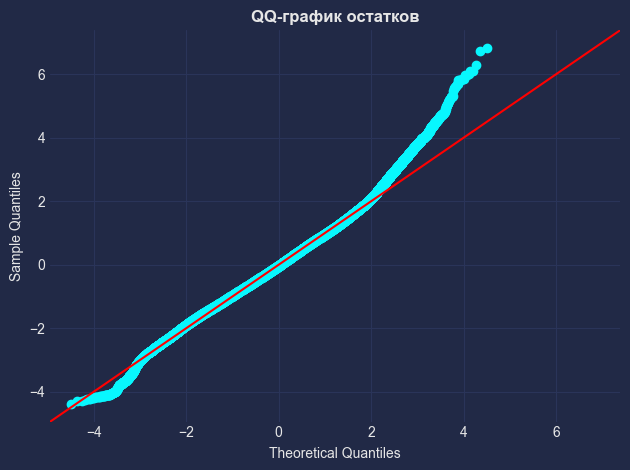

In [34]:
residuals = model_log_price_rob.resid

fig = sm.qqplot(residuals, line='45', fit=True)
plt.title("QQ-график остатков")
plt.show()

In [35]:
bp_test = het_breuschpagan(model_log_price_rob.resid, model_log_price_rob.model.exog)
lm_stat, lm_pvalue, f_stat, f_pvalue = bp_test

print("--------------------------------------------------------------------------------")
print("Результаты теста Бреуша-Пагана:")
print("--------------------------------------------------------------------------------")

print(f"LM statistic: {lm_stat:.4f}, LM p-value: {lm_pvalue:.4f}")
print(f"F statistic: {f_stat:.4f}, F p-value: {f_pvalue:.4f}")

if lm_pvalue < 0.05:
    print("Есть признаки гетероскедастичности (отвергаем H0).")
else:
    print("Нет статистически значимых признаков гетероскедастичности (не отвергаем H0).")

print("--------------------------------------------------------------------------------")

--------------------------------------------------------------------------------
Результаты теста Бреуша-Пагана:
--------------------------------------------------------------------------------
LM statistic: 23343.7452, LM p-value: 0.0000
F statistic: 843.6581, F p-value: 0.0000
Есть признаки гетероскедастичности (отвергаем H0).
--------------------------------------------------------------------------------


#### Попытка воспользоваться WLS

In [36]:
# Получаем остатки модели OLS с лог-трансформированным таргетом
resid = model_log_price.resid
abs_resid = np.abs(resid)

# Строим вспомогательную регрессию для оценки дисперсии ошибок
# Регистрируем логарифм абсолютных остатков на те же предикторы X
aux_model = sm.OLS(np.log(abs_resid), X).fit()

# Получаем предсказания логарифма стандартного отклонения и возвращаем в уровень стандартного отклонения
log_std_pred = aux_model.predict(X)
std_pred = np.exp(log_std_pred)

# Вычисляем веса: веса равны обратной величине квадратов оценённых стандартных отклонений
weights = 1 / (std_pred ** 2)

# Оцениваем модель методом WLS с вычисленными весами
model_log_price_wls = sm.WLS(y_log, X, weights=weights).fit()

# Выводим сводку результатов модели WLS
display(model_log_price_wls.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            WLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.937
Model:                            WLS   Adj. R-squared:                  0.937
Method:                 Least Squares   F-statistic:                 1.500e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:20   Log-Likelihood:                -67688.
No. Observations:              300153   AIC:                         1.354e+05
Df Residuals:                  300122   BIC:                         1.358e+05
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           10.5006      0.005   2186.075      0.000      10.491      10.510
duration                         0.0021   9.71e-05     22.093      0.000       0.002       0.002
days_left                       -0.0105   3.96e-05   -265.450      0.000      -0.011      -0.010
airline_Air_India                0.5535      0.004    151.351      0.000       0.546       0.561
airline_GO_FIRST                 0.4834      0.004    123.965      0.000       0.476       0.491
airline_Indigo                   0.3342      0.004     86.833      0.000       0.327       0.342
airline_SpiceJet                 0.5445      0.005    111.335      0.000       0.535       0.554
airline_Vistara                  0.6882      0.004    191.210      0.000       0.681       0.695
source_city_Chennai             -0.0346      0.002    -16.575      0.000      -0.039      -0.031
source_city_Delhi               -0.0353      0.002    -19.287      0.000      -0.039      -0.032
source_city_Hyderabad           -0.0782      0.002    -40.014      0.000      -0.082      -0.074
source_city_Kolkata              0.1283      0.002     70.801      0.000       0.125       0.132
source_city_Mumbai              -0.0354      0.002    -19.479      0.000      -0.039      -0.032
departure_time_Early_Morning     0.0134      0.002      7.525      0.000       0.010       0.017
departure_time_Evening          -0.0038      0.002     -2.089      0.037      -0.007      -0.000
departure_time_Late_Night        0.0440      0.008      5.391      0.000       0.028       0.060
departure_time_Morning           0.0323      0.002     18.339      0.000       0.029       0.036
departure_time_Night            -0.0004      0.002     -0.216      0.829      -0.004       0.003
stops_two_or_more                0.2417      0.003     90.672      0.000       0.236       0.247
stops_zero                      -0.5035      0.002   -218.186      0.000      -0.508      -0.499
arrival_time_Early_Morning      -0.0598      0.003    -21.270      0.000      -0.065      -0.054
arrival_time_Evening             0.0289      0.002     15.295      0.000       0.025       0.033
arrival_time_Late_Night          0.0195      0.003      6.148      0.000       0.013       0.026
arrival_time_Morning            -0.0074      0.002     -3.756      0.000      -0.011      -0.004
arrival_time_Night               0.0324      0.002     17.405      0.000       0.029       0.036
destination_city_Chennai        -0.0345      0.002    -16.982      0.000      -0.038      -0.030
destination_city_Delhi          -0.0329      0.002    -17.412      0.000      -0.037      -0.029
destination_city_Hyderabad      -0.0872      0.002    -43.977      0.000      -0.091      -0.083
destination_city_Kolkata         0.1049      0.002     56.959      0.000    

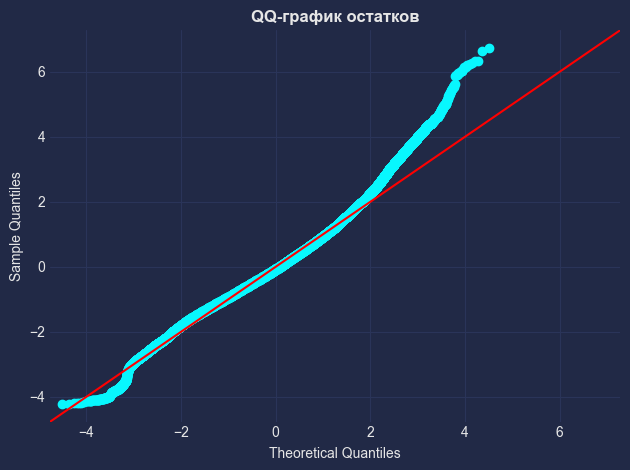

In [37]:
residuals = model_log_price_wls.resid

fig = sm.qqplot(residuals, line='45', fit=True)
plt.title("QQ-график остатков")
plt.show()

interval columns not set, guessing: ['duration', 'days_left', 'price']


Text(0.5, 1.0, 'Phik-корреляция между столбцами')

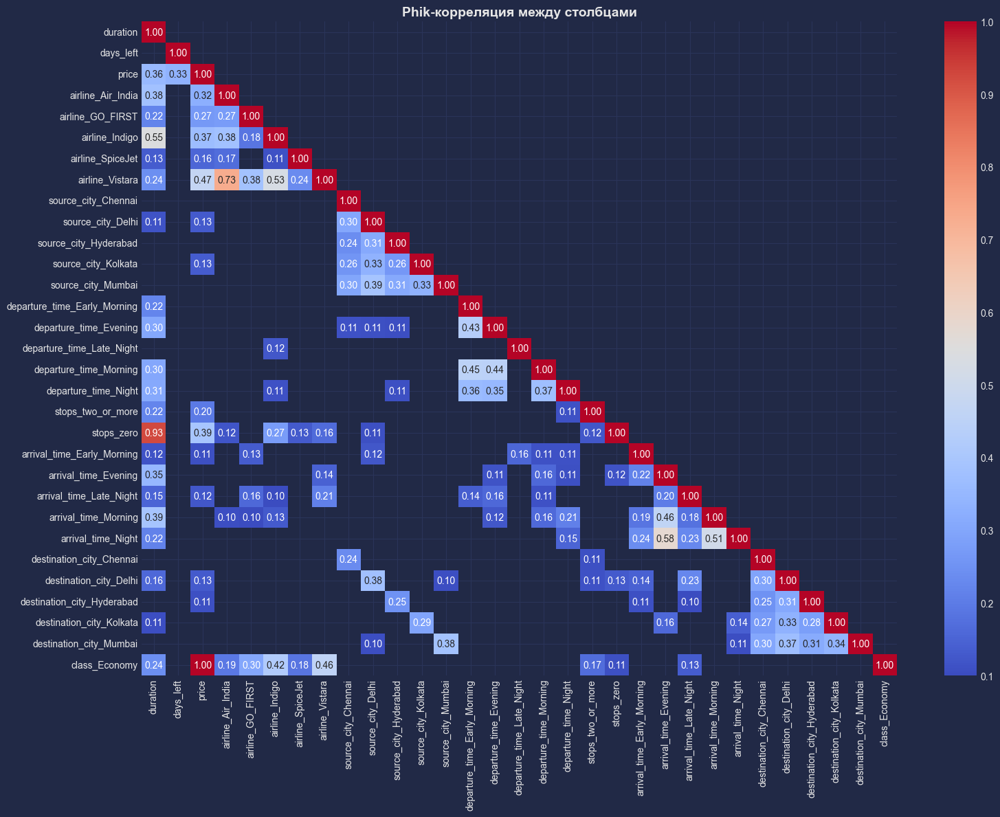

In [38]:
phik_corr = df_dummies.phik_matrix()

# Создаём маску для скрытия части выше главной диагонали
mask = np.triu(np.ones_like(phik_corr, dtype=bool), k=1)

# Убираем слабые корреляции
phik_corr_filtered = phik_corr.copy()
phik_corr_filtered[phik_corr_filtered < 0.1] = np.nan #условное ограничение - решил убрать ниже 0.1

plt.figure(figsize=(16, 12))
sns.heatmap(phik_corr_filtered, mask=mask, annot=True, fmt='.2f', cmap='coolwarm', vmin=0.1, vmax=1)

plt.title("Phik-корреляция между столбцами", fontsize=14)

### Построение модели линейной регрессии №2 методом МНК и её оценка

In [39]:
model2_columns = [
    'airline',
    'departure_time', 
    'stops', 
    'arrival_time',
    'class', 
    'duration', 
    'days_left', 
    'price'
]

df_model_1 = df[model2_columns].copy()

cat_columns_1 = list(df_model_1.columns[:-3])

df_dummies_1 = pd.get_dummies(df_model_1, columns=cat_columns_1, drop_first=True)

# Таргет или зависимая переменная
y1 = df_dummies_1['price']

# Оставляем только признаки
X1 = df_dummies_1.drop('price', axis=1).astype('float')

# Добавляем константу вручную (столбец единиц)
X1 = sm.add_constant(X1)

# Строим модель
model2 = sm.OLS(y1, X1).fit()

# Выводим сводку результатов
display(model2.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.908
Model:                            OLS   Adj. R-squared:                  0.908
Method:                 Least Squares   F-statistic:                 1.485e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:26   Log-Likelihood:            -3.0780e+06
No. Observations:              300153   AIC:                         6.156e+06
Df Residuals:                  300132   BIC:                         6.156e+06
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                          5.16e+04     84.755    608.769      0.000    5.14e+04    5.18e+04
duration                        58.9803      2.360     24.992      0.000      54.355      63.606
days_left                     -131.1771      0.928   -141.365      0.000    -132.996    -129.358
airline_Air_India              -35.2006     63.780     -0.552      0.581    -160.207      89.806
airline_GO_FIRST              1764.5911     71.331     24.738      0.000    1624.784    1904.399
airline_Indigo                2307.0307     65.068     35.456      0.000    2179.500    2434.562
airline_SpiceJet              2575.5353     92.475     27.851      0.000    2394.287    2756.783
airline_Vistara               3926.2566     61.796     63.536      0.000    3805.138    4047.375
departure_time_Early_Morning   903.5986     41.920     21.555      0.000     821.436     985.761
departure_time_Evening         806.9495     42.576     18.953      0.000     723.502     890.397
departure_time_Late_Night     1969.8838    194.788     10.113      0.000    1588.105    2351.663
departure_time_Morning         909.6684     41.098     22.134      0.000     829.118     990.219
departure_time_Night           775.8094     46.254     16.773      0.000     685.152     866.467
stops_two_or_more             2487.6545     62.725     39.659      0.000    2364.714    2610.595
stops_zero                   -7762.5356     46.641   -166.430      0.000   -7853.951   -7671.120
arrival_time_Early_Morning    -781.0547     66.707    -11.709      0.000    -911.798    -650.311
arrival_time_Evening          1207.7759     43.359     27.855      0.000    1122.793    1292.759
arrival_time_Late_Night        852.7402     70.512     12.094      0.000     714.539     990.941
arrival_time_Morning           712.0229     45.532     15.638      0.000     622.782     801.264
arrival_time_Night            1255.6122     42.508     29.538      0.000    1172.297    1338.927
class_Economy                -4.499e+04     30.636  -1468.363      0.000    -4.5e+04   -4.49e+04
==============================================================================
Omnibus:                    39477.301   Durbin-Watson:                   0.331
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           327345.781
Skew:                           0.366   Prob(JB):                         0.00
Kurtosis:                       8.063   Cond. No.                         489.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [40]:
# Таргет или зависимая переменная
y1_log = np.log(df_dummies_1['price'])

# Строим модель
model2_log = sm.OLS(y1_log, X1).fit()

# Выводим сводку результатов
display(model2_log.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.910
Model:                            OLS   Adj. R-squared:                  0.910
Method:                 Least Squares   F-statistic:                 1.514e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:26   Log-Likelihood:                -96915.
No. Observations:              300153   AIC:                         1.939e+05
Df Residuals:                  300132   BIC:                         1.941e+05
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           10.5808      0.004   2568.583      0.000      10.573      10.589
duration                         0.0044      0.000     38.354      0.000       0.004       0.005
days_left                       -0.0144   4.51e-05   -319.755      0.000      -0.015      -0.014
airline_Air_India                0.4976      0.003    160.533      0.000       0.492       0.504
airline_GO_FIRST                 0.4107      0.003    118.454      0.000       0.404       0.417
airline_Indigo                   0.3176      0.003    100.439      0.000       0.311       0.324
airline_SpiceJet                 0.4857      0.004    108.062      0.000       0.477       0.494
airline_Vistara                  0.6199      0.003    206.383      0.000       0.614       0.626
departure_time_Early_Morning     0.0154      0.002      7.582      0.000       0.011       0.019
departure_time_Evening          -0.0040      0.002     -1.947      0.051      -0.008    2.61e-05
departure_time_Late_Night        0.0677      0.009      7.148      0.000       0.049       0.086
departure_time_Morning           0.0374      0.002     18.744      0.000       0.034       0.041
departure_time_Night            -0.0069      0.002     -3.067      0.002      -0.011      -0.002
stops_two_or_more                0.2430      0.003     79.702      0.000       0.237       0.249
stops_zero                      -0.4571      0.002   -201.628      0.000      -0.462      -0.453
arrival_time_Early_Morning      -0.0847      0.003    -26.139      0.000      -0.091      -0.078
arrival_time_Evening             0.0425      0.002     20.182      0.000       0.038       0.047
arrival_time_Late_Night          0.0083      0.003      2.421      0.015       0.002       0.015
arrival_time_Morning            -0.0115      0.002     -5.198      0.000      -0.016      -0.007
arrival_time_Night               0.0244      0.002     11.810      0.000       0.020       0.028
class_Economy                   -2.0300      0.001  -1363.315      0.000      -2.033      -2.027
==============================================================================
Omnibus:                     4164.816   Durbin-Watson:                   0.289
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             6504.946
Skew:                           0.141   Prob(JB):                         0.00
Kurtosis:                       3.664   Cond. No.                         489.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [41]:
bp_test = het_breuschpagan(model2_log.resid, model2_log.model.exog)
lm_stat, lm_pvalue, f_stat, f_pvalue = bp_test

print("--------------------------------------------------------------------------------")
print("Результаты теста Бреуша-Пагана:")
print("--------------------------------------------------------------------------------")

print(f"LM statistic: {lm_stat:.4f}, LM p-value: {lm_pvalue:.4f}")
print(f"F statistic: {f_stat:.4f}, F p-value: {f_pvalue:.4f}")

if lm_pvalue < 0.05:
    print("Есть признаки гетероскедастичности (отвергаем H0).")
else:
    print("Нет статистически значимых признаков гетероскедастичности (не отвергаем H0).")

print("--------------------------------------------------------------------------------")

--------------------------------------------------------------------------------
Результаты теста Бреуша-Пагана:
--------------------------------------------------------------------------------
LM statistic: 21383.6305, LM p-value: 0.0000
F statistic: 1151.1150, F p-value: 0.0000
Есть признаки гетероскедастичности (отвергаем H0).
--------------------------------------------------------------------------------


In [42]:
# Строим модель
model2_log_rob = model2_log.get_robustcov_results(cov_type='HC1')

# Выводим сводку результатов
display(model2_log_rob.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.910
Model:                            OLS   Adj. R-squared:                  0.910
Method:                 Least Squares   F-statistic:                 1.963e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:27   Log-Likelihood:                -96915.
No. Observations:              300153   AIC:                         1.939e+05
Df Residuals:                  300132   BIC:                         1.941e+05
Df Model:                          20                                         
Covariance Type:                  HC1                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           10.5808      0.005   2182.820      0.000      10.571      10.590
duration                         0.0044      0.000     39.273      0.000       0.004       0.005
days_left                       -0.0144   4.83e-05   -298.594      0.000      -0.015      -0.014
airline_Air_India                0.4976      0.004    124.975      0.000       0.490       0.505
airline_GO_FIRST                 0.4107      0.004     96.554      0.000       0.402       0.419
airline_Indigo                   0.3176      0.004     75.117      0.000       0.309       0.326
airline_SpiceJet                 0.4857      0.005     90.818      0.000       0.475       0.496
airline_Vistara                  0.6199      0.004    158.926      0.000       0.612       0.628
departure_time_Early_Morning     0.0154      0.002      7.474      0.000       0.011       0.019
departure_time_Evening          -0.0040      0.002     -1.891      0.059      -0.008       0.000
departure_time_Late_Night        0.0677      0.010      6.533      0.000       0.047       0.088
departure_time_Morning           0.0374      0.002     18.093      0.000       0.033       0.041
departure_time_Night            -0.0069      0.002     -3.102      0.002      -0.011      -0.003
stops_two_or_more                0.2430      0.003     80.864      0.000       0.237       0.249
stops_zero                      -0.4571      0.003   -176.787      0.000      -0.462      -0.452
arrival_time_Early_Morning      -0.0847      0.003    -26.463      0.000      -0.091      -0.078
arrival_time_Evening             0.0425      0.002     19.470      0.000       0.038       0.047
arrival_time_Late_Night          0.0083      0.004      2.271      0.023       0.001       0.015
arrival_time_Morning            -0.0115      0.002     -5.113      0.000      -0.016      -0.007
arrival_time_Night               0.0244      0.002     11.431      0.000       0.020       0.029
class_Economy                   -2.0300      0.001  -1542.099      0.000      -2.033      -2.027
==============================================================================
Omnibus:                     4164.816   Durbin-Watson:                   0.289
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             6504.946
Skew:                           0.141   Prob(JB):                         0.00
Kurtosis:                       3.664   Cond. No.                         489.
==============================================================================

Notes:
[1] Standard Errors are heteroscedasticity robust (HC1)
"""

In [43]:
df_model_2 = df[model2_columns].copy()

for col in ['duration', 'days_left', 'price']:
    df_model_2[col] = np.log(df_model_2[col])

cat_columns_2 = list(df_model_2.columns[:-3])

df_dummies_2 = pd.get_dummies(df_model_2, columns=cat_columns_2, drop_first=True)

# Таргет или зависимая переменная
y2 = df_dummies_2['price']

# Оставляем только признаки
X2 = df_dummies_2.drop('price', axis=1).astype('float')

# Добавляем константу вручную (столбец единиц)
X2 = sm.add_constant(X2)

# Строим модель
model3 = sm.OLS(y2, X2).fit()

# Выводим сводку результатов
display(model3.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.916
Model:                            OLS   Adj. R-squared:                  0.916
Method:                 Least Squares   F-statistic:                 1.647e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:28   Log-Likelihood:                -85363.
No. Observations:              300153   AIC:                         1.708e+05
Df Residuals:                  300132   BIC:                         1.710e+05
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           10.9137      0.005   2011.831      0.000      10.903      10.924
duration                         0.0928      0.001     62.665      0.000       0.090       0.096
days_left                       -0.2809      0.001   -361.486      0.000      -0.282      -0.279
airline_Air_India                0.4738      0.003    158.987      0.000       0.468       0.480
airline_GO_FIRST                 0.4157      0.003    124.617      0.000       0.409       0.422
airline_Indigo                   0.3197      0.003    104.756      0.000       0.314       0.326
airline_SpiceJet                 0.4680      0.004    108.326      0.000       0.460       0.476
airline_Vistara                  0.6031      0.003    208.534      0.000       0.597       0.609
departure_time_Early_Morning     0.0122      0.002      6.195      0.000       0.008       0.016
departure_time_Evening          -0.0154      0.002     -7.738      0.000      -0.019      -0.012
departure_time_Late_Night        0.0731      0.009      8.023      0.000       0.055       0.091
departure_time_Morning           0.0341      0.002     17.734      0.000       0.030       0.038
departure_time_Night            -0.0177      0.002     -8.130      0.000      -0.022      -0.013
stops_two_or_more                0.2345      0.003     79.926      0.000       0.229       0.240
stops_zero                      -0.3517      0.003   -114.876      0.000      -0.358      -0.346
arrival_time_Early_Morning      -0.0873      0.003    -27.953      0.000      -0.093      -0.081
arrival_time_Evening             0.0428      0.002     21.089      0.000       0.039       0.047
arrival_time_Late_Night          0.0159      0.003      4.839      0.000       0.009       0.022
arrival_time_Morning            -0.0192      0.002     -8.970      0.000      -0.023      -0.015
arrival_time_Night               0.0220      0.002     11.088      0.000       0.018       0.026
class_Economy                   -2.0322      0.001  -1419.102      0.000      -2.035      -2.029
==============================================================================
Omnibus:                     4336.619   Durbin-Watson:                   0.313
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             7861.050
Skew:                           0.078   Prob(JB):                         0.00
Kurtosis:                       3.777   Cond. No.                         64.4
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

#### Попытка использовать WLS на логарифмированных данных

In [44]:
# Получаем остатки модели OLS
resid = model2_log.resid

# Берём модуль (или квадрат) остатков
abs_resid = np.abs(resid)

# Строим вспомогательную регрессию лог(абсолютных остатков) на те же признаки X1
aux_model = sm.OLS(np.log(abs_resid), X1).fit()

# Получаем предсказания логарифма стандартного отклонения
log_std_pred = aux_model.predict(X1)

# Преобразуем их в оценку стандартного отклонения
std_pred = np.exp(log_std_pred)

# Вычисляем веса: 1 / (оценка дисперсии)
weights = 1 / (std_pred ** 2)

# Оцениваем модель WLS с вычисленными весами
model2_log_wls = sm.WLS(y1_log, X1, weights=weights).fit()
model2_log_wls_rob = model2_log_wls.get_robustcov_results(cov_type='HC1')

# Выводим сводку результатов
display(model2_log_wls.summary())
display(model2_log_wls_rob.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            WLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.931
Model:                            WLS   Adj. R-squared:                  0.931
Method:                 Least Squares   F-statistic:                 2.021e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:29   Log-Likelihood:                -80084.
No. Observations:              300153   AIC:                         1.602e+05
Df Residuals:                  300132   BIC:                         1.604e+05
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           10.4852      0.005   2282.012      0.000      10.476      10.494
duration                         0.0028      0.000     28.013      0.000       0.003       0.003
days_left                       -0.0109   4.14e-05   -263.568      0.000      -0.011      -0.011
airline_Air_India                0.5418      0.004    140.693      0.000       0.534       0.549
airline_GO_FIRST                 0.4760      0.004    114.236      0.000       0.468       0.484
airline_Indigo                   0.3301      0.004     81.271      0.000       0.322       0.338
airline_SpiceJet                 0.5537      0.005    105.774      0.000       0.543       0.564
airline_Vistara                  0.6694      0.004    176.422      0.000       0.662       0.677
departure_time_Early_Morning     0.0150      0.002      8.074      0.000       0.011       0.019
departure_time_Evening           0.0058      0.002      3.038      0.002       0.002       0.010
departure_time_Late_Night        0.0518      0.009      5.513      0.000       0.033       0.070
departure_time_Morning           0.0354      0.002     19.132      0.000       0.032       0.039
departure_time_Night             0.0048      0.002      2.369      0.018       0.001       0.009
stops_two_or_more                0.2690      0.003     96.165      0.000       0.264       0.274
stops_zero                      -0.5187      0.002   -207.624      0.000      -0.524      -0.514
arrival_time_Early_Morning      -0.0781      0.003    -27.150      0.000      -0.084      -0.072
arrival_time_Evening             0.0442      0.002     22.760      0.000       0.040       0.048
arrival_time_Late_Night          0.0135      0.003      4.020      0.000       0.007       0.020
arrival_time_Morning             0.0022      0.002      1.092      0.275      -0.002       0.006
arrival_time_Night               0.0323      0.002     16.773      0.000       0.028       0.036
class_Economy                   -2.0749      0.001  -1634.205      0.000      -2.077      -2.072
==============================================================================
Omnibus:                     1529.773   Durbin-Watson:                   0.277
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1798.429
Skew:                           0.117   Prob(JB):                         0.00
Kurtosis:                       3.298   Cond. No.                         573.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

<class 'statsmodels.iolib.summary.Summary'>
"""
                            WLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.931
Model:                            WLS   Adj. R-squared:                  0.931
Method:                 Least Squares   F-statistic:                 2.380e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:29   Log-Likelihood:                -80084.
No. Observations:              300153   AIC:                         1.602e+05
Df Residuals:                  300132   BIC:                         1.604e+05
Df Model:                          20                                         
Covariance Type:                  HC1                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           10.4852      0.004   2330.537      0.000      10.476      10.494
duration                         0.0028      0.000     27.329      0.000       0.003       0.003
days_left                       -0.0109   4.39e-05   -248.181      0.000      -0.011      -0.011
airline_Air_India                0.5418      0.004    144.567      0.000       0.534       0.549
airline_GO_FIRST                 0.4760      0.004    118.343      0.000       0.468       0.484
airline_Indigo                   0.3301      0.004     80.130      0.000       0.322       0.338
airline_SpiceJet                 0.5537      0.005    106.287      0.000       0.543       0.564
airline_Vistara                  0.6694      0.004    181.994      0.000       0.662       0.677
departure_time_Early_Morning     0.0150      0.002      8.093      0.000       0.011       0.019
departure_time_Evening           0.0058      0.002      3.019      0.003       0.002       0.010
departure_time_Late_Night        0.0518      0.009      5.694      0.000       0.034       0.070
departure_time_Morning           0.0354      0.002     19.042      0.000       0.032       0.039
departure_time_Night             0.0048      0.002      2.425      0.015       0.001       0.009
stops_two_or_more                0.2690      0.003     97.345      0.000       0.264       0.274
stops_zero                      -0.5187      0.002   -216.984      0.000      -0.523      -0.514
arrival_time_Early_Morning      -0.0781      0.003    -26.939      0.000      -0.084      -0.072
arrival_time_Evening             0.0442      0.002     22.711      0.000       0.040       0.048
arrival_time_Late_Night          0.0135      0.003      4.097      0.000       0.007       0.020
arrival_time_Morning             0.0022      0.002      1.104      0.270      -0.002       0.006
arrival_time_Night               0.0323      0.002     16.721      0.000       0.028       0.036
class_Economy                   -2.0749      0.001  -1692.518      0.000      -2.077      -2.072
==============================================================================
Omnibus:                     1529.773   Durbin-Watson:                   0.277
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1798.429
Skew:                           0.117   Prob(JB):                         0.00
Kurtosis:                       3.298   Cond. No.                         573.
==============================================================================

Notes:
[1] Standard Errors are heteroscedasticity robust (HC1)
"""

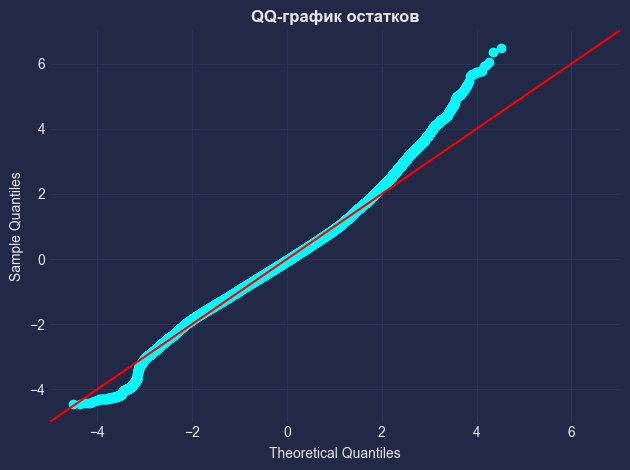

In [45]:
residuals = model2_log_wls_rob.resid

fig = sm.qqplot(residuals, line='45', fit=True)
plt.title("QQ-график остатков")
plt.show()

#### Пробую финальную модель

In [46]:
# Удаляем незначимый параметр из матрицы признаков
X1_final = X1.drop(columns=['arrival_time_Morning']).astype('float')

# Убеждаемся, что константа присутствует
X1_final = sm.add_constant(X1_final)

# Строим OLS-модель на новой выборке для расчёта остатков (для оценки весов)
model_final_ols = sm.OLS(y1_log, X1_final).fit()

# Получаем остатки и вычисляем абсолютные остатки
resid_final = model_final_ols.resid
abs_resid_final = np.abs(resid_final)

# Строим вспомогательную регрессию лог(абс. остатков) на X1_final
aux_model_final = sm.OLS(np.log(abs_resid_final), X1_final).fit()

# Получаем предсказания логарифма стандартного отклонения и возвращаем в уровень стандартного отклонения
log_std_pred_final = aux_model_final.predict(X1_final)
std_pred_final = np.exp(log_std_pred_final)

# Вычисляем веса: 1 / (std_pred_final^2)
weights_final = 1 / (std_pred_final ** 2)

# Строим финальную WLS-модель с лог-трансформированным таргетом, используя вычисленные веса
model2_log_wls_final = sm.WLS(y1_log, X1_final, weights=weights_final).fit()

display(model2_log_wls_final.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            WLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.931
Model:                            WLS   Adj. R-squared:                  0.931
Method:                 Least Squares   F-statistic:                 2.128e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:32   Log-Likelihood:                -80075.
No. Observations:              300153   AIC:                         1.602e+05
Df Residuals:                  300133   BIC:                         1.604e+05
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           10.4862      0.004   2363.511      0.000      10.477      10.495
duration                         0.0028      0.000     28.093      0.000       0.003       0.003
days_left                       -0.0109   4.14e-05   -263.470      0.000      -0.011      -0.011
airline_Air_India                0.5421      0.004    140.570      0.000       0.534       0.550
airline_GO_FIRST                 0.4761      0.004    114.162      0.000       0.468       0.484
airline_Indigo                   0.3301      0.004     81.186      0.000       0.322       0.338
airline_SpiceJet                 0.5540      0.005    105.756      0.000       0.544       0.564
airline_Vistara                  0.6697      0.004    176.273      0.000       0.662       0.677
departure_time_Early_Morning     0.0149      0.002      8.017      0.000       0.011       0.019
departure_time_Evening           0.0059      0.002      3.098      0.002       0.002       0.010
departure_time_Late_Night        0.0518      0.009      5.519      0.000       0.033       0.070
departure_time_Morning           0.0353      0.002     19.100      0.000       0.032       0.039
departure_time_Night             0.0049      0.002      2.416      0.016       0.001       0.009
stops_two_or_more                0.2692      0.003     96.412      0.000       0.264       0.275
stops_zero                      -0.5188      0.002   -207.668      0.000      -0.524      -0.514
arrival_time_Early_Morning      -0.0795      0.003    -31.069      0.000      -0.084      -0.074
arrival_time_Evening             0.0428      0.001     29.228      0.000       0.040       0.046
arrival_time_Late_Night          0.0120      0.003      3.874      0.000       0.006       0.018
arrival_time_Night               0.0308      0.001     21.413      0.000       0.028       0.034
class_Economy                   -2.0749      0.001  -1634.609      0.000      -2.077      -2.072
==============================================================================
Omnibus:                     1528.216   Durbin-Watson:                   0.277
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1797.734
Skew:                           0.117   Prob(JB):                         0.00
Kurtosis:                       3.298   Cond. No.                         573.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [47]:
# Применяем робастую оценку стандартных ошибок (HC1)
model2_log_wls_rob_final = model2_log_wls_final.get_robustcov_results(cov_type='HC1')

display(model2_log_wls_rob_final.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            WLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.931
Model:                            WLS   Adj. R-squared:                  0.931
Method:                 Least Squares   F-statistic:                 2.505e+05
Date:                Fri, 21 Mar 2025   Prob (F-statistic):               0.00
Time:                        00:46:32   Log-Likelihood:                -80075.
No. Observations:              300153   AIC:                         1.602e+05
Df Residuals:                  300133   BIC:                         1.604e+05
Df Model:                          19                                         
Covariance Type:                  HC1                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const                           10.4862      0.004   2427.968      0.000      10.478      10.495
duration                         0.0028      0.000     27.393      0.000       0.003       0.003
days_left                       -0.0109   4.39e-05   -248.033      0.000      -0.011      -0.011
airline_Air_India                0.5421      0.004    144.653      0.000       0.535       0.549
airline_GO_FIRST                 0.4761      0.004    118.381      0.000       0.468       0.484
airline_Indigo                   0.3301      0.004     80.123      0.000       0.322       0.338
airline_SpiceJet                 0.5540      0.005    106.414      0.000       0.544       0.564
airline_Vistara                  0.6697      0.004    182.127      0.000       0.662       0.677
departure_time_Early_Morning     0.0149      0.002      8.042      0.000       0.011       0.019
departure_time_Evening           0.0059      0.002      3.075      0.002       0.002       0.010
departure_time_Late_Night        0.0518      0.009      5.702      0.000       0.034       0.070
departure_time_Morning           0.0353      0.002     19.018      0.000       0.032       0.039
departure_time_Night             0.0049      0.002      2.472      0.013       0.001       0.009
stops_two_or_more                0.2692      0.003     97.446      0.000       0.264       0.275
stops_zero                      -0.5188      0.002   -217.079      0.000      -0.523      -0.514
arrival_time_Early_Morning      -0.0795      0.003    -30.948      0.000      -0.085      -0.074
arrival_time_Evening             0.0428      0.001     29.993      0.000       0.040       0.046
arrival_time_Late_Night          0.0120      0.003      3.980      0.000       0.006       0.018
arrival_time_Night               0.0308      0.001     21.874      0.000       0.028       0.034
class_Economy                   -2.0749      0.001  -1692.500      0.000      -2.077      -2.072
==============================================================================
Omnibus:                     1528.216   Durbin-Watson:                   0.277
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1797.734
Skew:                           0.117   Prob(JB):                         0.00
Kurtosis:                       3.298   Cond. No.                         573.
==============================================================================

Notes:
[1] Standard Errors are heteroscedasticity robust (HC1)
"""

#### Тест Бреуша-Пагана для финальной модели

In [48]:
bp_test = het_breuschpagan(model2_log_wls_rob_final.resid, model2_log_wls_rob_final.model.exog)
lm_stat, lm_pvalue, f_stat, f_pvalue = bp_test

print("--------------------------------------------------------------------------------")
print("Результаты теста Бреуша-Пагана:")
print("--------------------------------------------------------------------------------")

print(f"LM statistic: {lm_stat:.4f}, LM p-value: {lm_pvalue:.4f}")
print(f"F statistic: {f_stat:.4f}, F p-value: {f_pvalue:.4f}")

if lm_pvalue < 0.05:
    print("Есть признаки гетероскедастичности (отвергаем H0).")
else:
    print("Нет статистически значимых признаков гетероскедастичности (не отвергаем H0).")

print("--------------------------------------------------------------------------------")

--------------------------------------------------------------------------------
Результаты теста Бреуша-Пагана:
--------------------------------------------------------------------------------
LM statistic: 35217.5771, LM p-value: 0.0000
F statistic: 2099.8080, F p-value: 0.0000
Есть признаки гетероскедастичности (отвергаем H0).
--------------------------------------------------------------------------------


#### VIF для финальной модели

In [49]:
# Создадим DataFrame для VIF
X_no_const = X1_final.drop('const', axis=1, errors='ignore')  # если добавляли константу
vif_data = pd.DataFrame()
vif_data['feature'] = X_no_const.columns
vif_data['VIF'] = [
    variance_inflation_factor(X_no_const.values, i)
    for i in range(X_no_const.shape[1])
]

display(vif_data.sort_values(by='VIF', ascending=False).style.background_gradient('coolwarm'))

,feature,VIF
0,duration,6.507353
6,airline_Vistara,5.684070
2,airline_Air_India,4.262164
1,days_left,4.200859
18,class_Economy,3.584938
4,airline_Indigo,2.404030
8,departure_time_Evening,2.316847
10,departure_time_Morning,2.313137
7,departure_time_Early_Morning,2.218782
11,departure_time_Night,2.003468


#### QQ-plot для финальной модели

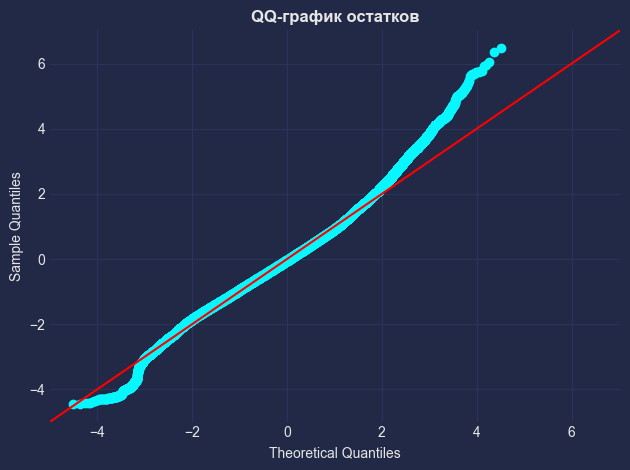

In [50]:
residuals = model2_log_wls_rob_final.resid

fig = sm.qqplot(residuals, line='45', fit=True)
plt.title("QQ-график остатков")
plt.show()

### Какую и почему модель выбрал?

В ходе анализа были построены несколько моделей. В качестве промежуточной модели использовалась `model2_log_wls` (WLS с логарифмированным таргетом), а финальная спецификация – `model2_log_wls_rob_final`, полученная путем исключения незначимого параметра (`arrival_time_Morning`) и применения робастых стандартных ошибок.

**Критерии и метрики сравнения**

- ***Скорректированный R²***  
  Промежуточная модель имела скорректированный R² около 0.928, а финальная – около 0.931. Это указывает на то, что исключение незначимого параметра позволило улучшить объясняющую способность модели без потери важной информации.

- ***Информационные критерии (AIC/BIC)***    
  Финальная модель демонстрирует более низкие значения AIC и BIC, что свидетельствует о лучшем соотношении сложности модели и качества её подгонки к данным.

- ***Значимость коэффициентов***  
  В промежуточной модели один из параметров (`arrival_time_Morning`) оказался незначимым (p-value > 0.05). Исключение этого параметра в финальной модели позволило добиться статистической значимости всех оставшихся переменных, что улучшает интерпретируемость влияния факторов на логарифм цены.

- ***Тесты на гетероскедастичность***  
  Несмотря на то, что тест Breusch–Pagan в промежуточной модели указывал на наличие гетероскедастичности, применение метода WLS и корректировка стандартных ошибок робастным способом (HC1) обеспечивают достоверные оценки коэффициентов. Как я полагаю, финальная модель демонстрирует корректные доверительные интервалы и p-value, что позволяет делать надежные выводы. Исправить гетероскедастичность полностью я пытался, но, вероятно, без каких-то методов или удаления выбросов (думаю, что именно это могло помочь). Конечно, данные перелётов сами по себе являются не особо прекрасными данными : (

**Трактовка метрик**

- Скорректированный R² отражает долю объясненной вариации с учетом количества предикторов. Его рост говорит о том, что финальная модель стала лучше объяснять зависимую переменную, несмотря на уменьшение числа признаков.
- AIC и BIC помогают оценить, насколько модель оптимальна по соотношению точности и сложности. Более низкие значения в финальной модели свидетельствуют о том, что модель менее переобучена и имеет более оптимальную спецификацию.
- Значимость коэффициентов (p-value) позволяет определить, какие переменные вносят существенный вклад в объяснение логарифма цены. Исключение незначимого параметра улучшает статистическую надежность модели.
- Тесты на гетероскедастичность информируют о том, насколько постоянна дисперсия ошибок. Хотя гетероскедастичность сохраняется, применение WLS и робастых ошибок позволяет получить корректные стандартные ошибки, что важно для достоверности статистических выводов. Если я правильно помню, то на одной из лекций был момент про то, что её не всегда убирают из-за невозможности в некоторых моментах (надеюсь, правильно помню).

**Итоговый вывод**

Финальная модель `model2_log_wls_rob_final` была выбрана в пользу промежуточной спецификации, поскольку она:
- Обеспечивает более высокий скорректированный R²,
- Имеет более низкие значения AIC/BIC,
- Не содержит незначимых переменных, что повышает интерпретируемость,
- Корректно учитывает гетероскедастичность через применение метода WLS и робастых стандартных ошибок.

Таким образом, данная модель является более точной, интерпретируемой и статистически обоснованной для прогнозирования логарифма цены авиабилетов.

## Заключение

1. **Разница между группами (`Business`/`Economy`, `Direct`/`Stop`) подтверждается**  
   - Business в среднем дороже Economy примерно на ~46 тыс. ₽;  
   - Direct в среднем дешевле Stop на ~13 тыс. ₽;  
   - Перелёт в Business занимает в среднем на ~2 часа дольше, чем в Economy.  
   - Все интервалы для разниц находятся строго выше/ниже нуля, что свидетельствует о статистически значимой разнице.
2. **Регрессионный анализ**  
   - Итоговая линейная модель (с логарифмированным таргетом и WLS + робастными стандартными ошибками) объясняет около 91% вариации цены (скорректированный \(R^2 \approx 0.91\)).  
   - Исключение незначимых факторов помогло улучшить интерпретацию и качество модели (AIC/BIC стали ниже, скорректированный \(R^2\) выше).  
   - При этом выявлены признаки гетероскедастичности и некоторая мультиколлинеарность (VIF до ~7). Применение робастных стандартных ошибок даёт более корректные выводы о значимости коэффициентов.
3. **Рекомендации и дальнейшие шаги**  
   - Для повышения качества модели: рассмотреть устранение (или трансформацию) факторов с высоким VIF, использовать методы для учёта автокорреляции, проверить влияние выбросов.  
   - С точки зрения продукта: при наличии существенного отставания одной из групп (например, пересадки vs прямые рейсы) можно провести A/B-тесты по ценообразованию, бонусам и дополнительным услугам, чтобы выровнять показатели.  

В целом, выполненный анализ показывает статистически значимые различия между сегментами рынка и подтверждает значимость ключевых факторов в определении цены билета.